# Session (475165_f1_stage2_day2)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f1_stage2_day2" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f1"
day = "day2"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (35967, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


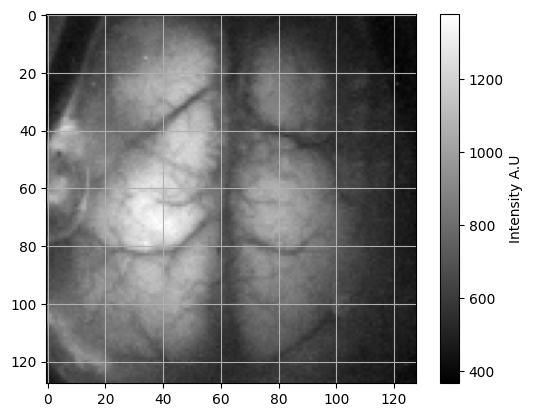

frame number 6000 plotted


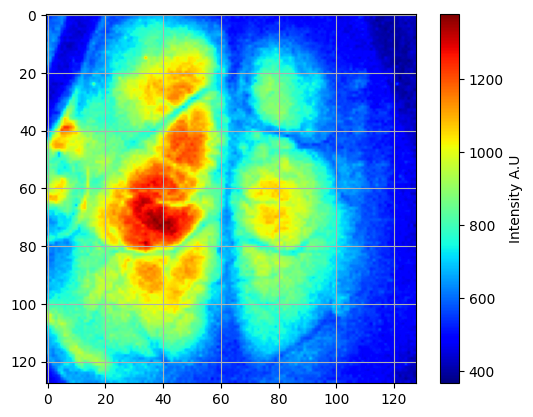

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 447.6848876953125 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 503.64549865722654


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 72
Number of double_flash pairs: 36
Number of single_flash: 44
Number of total flashes: 116


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/116 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/116 [00:01<02:31,  1.32s/it]

  2%|█▍                                                                                | 2/116 [00:02<02:36,  1.37s/it]

  3%|██                                                                                | 3/116 [00:04<02:30,  1.33s/it]

  3%|██▊                                                                               | 4/116 [00:05<02:28,  1.32s/it]

  4%|███▌                                                                              | 5/116 [00:06<02:27,  1.33s/it]

  5%|████▏                                                                             | 6/116 [00:08<02:29,  1.36s/it]

  6%|████▉                                                                             | 7/116 [00:09<02:26,  1.35s/it]

  7%|█████▋                                                                            | 8/116 [00:10<02:25,  1.35s/it]

  8%|██████▎                                                                           | 9/116 [00:12<02:26,  1.37s/it]

  9%|██████▉                                                                          | 10/116 [00:13<02:24,  1.37s/it]

  9%|███████▋                                                                         | 11/116 [00:14<02:21,  1.35s/it]

 10%|████████▍                                                                        | 12/116 [00:16<02:19,  1.34s/it]

 11%|█████████                                                                        | 13/116 [00:17<02:18,  1.35s/it]

 12%|█████████▊                                                                       | 14/116 [00:18<02:15,  1.33s/it]

 13%|██████████▍                                                                      | 15/116 [00:20<02:16,  1.35s/it]

 14%|███████████▏                                                                     | 16/116 [00:21<02:11,  1.31s/it]

 15%|███████████▊                                                                     | 17/116 [00:22<02:10,  1.32s/it]

 16%|████████████▌                                                                    | 18/116 [00:24<02:13,  1.36s/it]

 16%|█████████████▎                                                                   | 19/116 [00:25<02:13,  1.38s/it]

 17%|█████████████▉                                                                   | 20/116 [00:27<02:12,  1.38s/it]

 18%|██████████████▋                                                                  | 21/116 [00:28<02:11,  1.39s/it]

 19%|███████████████▎                                                                 | 22/116 [00:29<02:06,  1.34s/it]

 20%|████████████████                                                                 | 23/116 [00:30<02:03,  1.32s/it]

 21%|████████████████▊                                                                | 24/116 [00:32<02:03,  1.35s/it]

 22%|█████████████████▍                                                               | 25/116 [00:33<02:02,  1.35s/it]

 22%|██████████████████▏                                                              | 26/116 [00:35<02:02,  1.36s/it]

 23%|██████████████████▊                                                              | 27/116 [00:36<02:03,  1.38s/it]

 24%|███████████████████▌                                                             | 28/116 [00:37<02:02,  1.39s/it]

 25%|████████████████████▎                                                            | 29/116 [00:39<01:59,  1.37s/it]

 26%|████████████████████▉                                                            | 30/116 [00:40<01:56,  1.36s/it]

 27%|█████████████████████▋                                                           | 31/116 [00:41<01:52,  1.33s/it]

 28%|██████████████████████▎                                                          | 32/116 [00:43<01:53,  1.36s/it]

 28%|███████████████████████                                                          | 33/116 [00:44<01:55,  1.39s/it]

 29%|███████████████████████▋                                                         | 34/116 [00:46<01:54,  1.39s/it]

 30%|████████████████████████▍                                                        | 35/116 [00:47<01:53,  1.40s/it]

 31%|█████████████████████████▏                                                       | 36/116 [00:48<01:51,  1.39s/it]

 32%|█████████████████████████▊                                                       | 37/116 [00:50<01:48,  1.37s/it]

 33%|██████████████████████████▌                                                      | 38/116 [00:51<01:48,  1.39s/it]

 34%|███████████████████████████▏                                                     | 39/116 [00:53<01:45,  1.37s/it]

 34%|███████████████████████████▉                                                     | 40/116 [00:54<01:44,  1.38s/it]

 35%|████████████████████████████▋                                                    | 41/116 [00:55<01:41,  1.36s/it]

 36%|█████████████████████████████▎                                                   | 42/116 [00:56<01:38,  1.33s/it]

 37%|██████████████████████████████                                                   | 43/116 [00:58<01:36,  1.33s/it]

 38%|██████████████████████████████▋                                                  | 44/116 [00:59<01:37,  1.36s/it]

 39%|███████████████████████████████▍                                                 | 45/116 [01:01<01:34,  1.34s/it]

 40%|████████████████████████████████                                                 | 46/116 [01:02<01:32,  1.32s/it]

 41%|████████████████████████████████▊                                                | 47/116 [01:03<01:33,  1.35s/it]

 41%|█████████████████████████████████▌                                               | 48/116 [01:05<01:33,  1.37s/it]

 42%|██████████████████████████████████▏                                              | 49/116 [01:06<01:29,  1.34s/it]

 43%|██████████████████████████████████▉                                              | 50/116 [01:07<01:26,  1.31s/it]

 44%|███████████████████████████████████▌                                             | 51/116 [01:09<01:27,  1.35s/it]

 45%|████████████████████████████████████▎                                            | 52/116 [01:10<01:27,  1.36s/it]

 46%|█████████████████████████████████████                                            | 53/116 [01:11<01:24,  1.33s/it]

 47%|█████████████████████████████████████▋                                           | 54/116 [01:13<01:21,  1.32s/it]

 47%|██████████████████████████████████████▍                                          | 55/116 [01:14<01:20,  1.32s/it]

 48%|███████████████████████████████████████                                          | 56/116 [01:15<01:19,  1.33s/it]

 49%|███████████████████████████████████████▊                                         | 57/116 [01:17<01:18,  1.34s/it]

 50%|████████████████████████████████████████▌                                        | 58/116 [01:18<01:17,  1.33s/it]

 51%|█████████████████████████████████████████▏                                       | 59/116 [01:19<01:15,  1.33s/it]

 52%|█████████████████████████████████████████▉                                       | 60/116 [01:21<01:15,  1.35s/it]

 53%|██████████████████████████████████████████▌                                      | 61/116 [01:22<01:14,  1.36s/it]

 53%|███████████████████████████████████████████▎                                     | 62/116 [01:23<01:12,  1.34s/it]

 54%|███████████████████████████████████████████▉                                     | 63/116 [01:25<01:10,  1.34s/it]

 55%|████████████████████████████████████████████▋                                    | 64/116 [01:26<01:08,  1.31s/it]

 56%|█████████████████████████████████████████████▍                                   | 65/116 [01:27<01:06,  1.29s/it]

 57%|██████████████████████████████████████████████                                   | 66/116 [01:28<01:04,  1.29s/it]

 58%|██████████████████████████████████████████████▊                                  | 67/116 [01:30<01:02,  1.28s/it]

 59%|███████████████████████████████████████████████▍                                 | 68/116 [01:31<01:02,  1.31s/it]

 59%|████████████████████████████████████████████████▏                                | 69/116 [01:32<01:01,  1.31s/it]

 60%|████████████████████████████████████████████████▉                                | 70/116 [01:34<01:00,  1.31s/it]

 61%|█████████████████████████████████████████████████▌                               | 71/116 [01:35<00:59,  1.33s/it]

 62%|██████████████████████████████████████████████████▎                              | 72/116 [01:36<00:57,  1.30s/it]

 63%|██████████████████████████████████████████████████▉                              | 73/116 [01:38<00:57,  1.35s/it]

 64%|███████████████████████████████████████████████████▋                             | 74/116 [01:39<00:58,  1.38s/it]

 65%|████████████████████████████████████████████████████▎                            | 75/116 [01:41<00:56,  1.38s/it]

 66%|█████████████████████████████████████████████████████                            | 76/116 [01:42<00:54,  1.37s/it]

 66%|█████████████████████████████████████████████████████▊                           | 77/116 [01:43<00:52,  1.36s/it]

 67%|██████████████████████████████████████████████████████▍                          | 78/116 [01:45<00:52,  1.39s/it]

 68%|███████████████████████████████████████████████████████▏                         | 79/116 [01:46<00:53,  1.43s/it]

 69%|███████████████████████████████████████████████████████▊                         | 80/116 [01:48<00:51,  1.42s/it]

 70%|████████████████████████████████████████████████████████▌                        | 81/116 [01:49<00:48,  1.38s/it]

 71%|█████████████████████████████████████████████████████████▎                       | 82/116 [01:50<00:47,  1.39s/it]

 72%|█████████████████████████████████████████████████████████▉                       | 83/116 [01:52<00:45,  1.37s/it]

 72%|██████████████████████████████████████████████████████████▋                      | 84/116 [01:53<00:43,  1.36s/it]

 73%|███████████████████████████████████████████████████████████▎                     | 85/116 [01:54<00:42,  1.37s/it]

 74%|████████████████████████████████████████████████████████████                     | 86/116 [01:56<00:40,  1.36s/it]

 75%|████████████████████████████████████████████████████████████▊                    | 87/116 [01:57<00:38,  1.34s/it]

 76%|█████████████████████████████████████████████████████████████▍                   | 88/116 [01:58<00:36,  1.32s/it]

 77%|██████████████████████████████████████████████████████████████▏                  | 89/116 [02:00<00:35,  1.31s/it]

 78%|██████████████████████████████████████████████████████████████▊                  | 90/116 [02:01<00:34,  1.31s/it]

 78%|███████████████████████████████████████████████████████████████▌                 | 91/116 [02:02<00:32,  1.31s/it]

 79%|████████████████████████████████████████████████████████████████▏                | 92/116 [02:04<00:32,  1.35s/it]

 80%|████████████████████████████████████████████████████████████████▉                | 93/116 [02:05<00:31,  1.35s/it]

 81%|█████████████████████████████████████████████████████████████████▋               | 94/116 [02:06<00:29,  1.36s/it]

 82%|██████████████████████████████████████████████████████████████████▎              | 95/116 [02:08<00:28,  1.38s/it]

 83%|███████████████████████████████████████████████████████████████████              | 96/116 [02:09<00:27,  1.37s/it]

 84%|███████████████████████████████████████████████████████████████████▋             | 97/116 [02:11<00:26,  1.38s/it]

 84%|████████████████████████████████████████████████████████████████████▍            | 98/116 [02:12<00:24,  1.36s/it]

 85%|█████████████████████████████████████████████████████████████████████▏           | 99/116 [02:13<00:23,  1.36s/it]

 86%|████████████████████████████████████████████████████████████████████▉           | 100/116 [02:15<00:21,  1.37s/it]

 87%|█████████████████████████████████████████████████████████████████████▋          | 101/116 [02:16<00:20,  1.35s/it]

 88%|██████████████████████████████████████████████████████████████████████▎         | 102/116 [02:17<00:19,  1.37s/it]

 89%|███████████████████████████████████████████████████████████████████████         | 103/116 [02:19<00:17,  1.35s/it]

 90%|███████████████████████████████████████████████████████████████████████▋        | 104/116 [02:20<00:16,  1.34s/it]

 91%|████████████████████████████████████████████████████████████████████████▍       | 105/116 [02:21<00:14,  1.31s/it]

 91%|█████████████████████████████████████████████████████████████████████████       | 106/116 [02:23<00:13,  1.32s/it]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 107/116 [02:24<00:11,  1.33s/it]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 108/116 [02:25<00:10,  1.32s/it]

 94%|███████████████████████████████████████████████████████████████████████████▏    | 109/116 [02:27<00:09,  1.33s/it]

 95%|███████████████████████████████████████████████████████████████████████████▊    | 110/116 [02:28<00:08,  1.33s/it]

 96%|████████████████████████████████████████████████████████████████████████████▌   | 111/116 [02:29<00:06,  1.32s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▏  | 112/116 [02:31<00:05,  1.34s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▉  | 113/116 [02:32<00:04,  1.35s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▌ | 114/116 [02:33<00:02,  1.34s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▎| 115/116 [02:35<00:01,  1.34s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 116/116 [02:36<00:00,  1.36s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 116/116 [02:36<00:00,  1.35s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 20%|███████████████▋                                                                | 25/128 [00:00<00:00, 245.18it/s]

 42%|█████████████████████████████████▊                                              | 54/128 [00:00<00:00, 266.72it/s]

 63%|██████████████████████████████████████████████████▋                             | 81/128 [00:00<00:00, 254.49it/s]

 84%|██████████████████████████████████████████████████████████████████▋            | 108/128 [00:00<00:00, 256.51it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 249.60it/s]

  0%|                                                                                        | 0/34142 [00:00<?, ?it/s]

  0%|                                                                              | 28/34142 [00:00<02:06, 269.32it/s]

  0%|▏                                                                             | 55/34142 [00:00<02:18, 246.90it/s]

  0%|▏                                                                             | 80/34142 [00:00<02:22, 239.01it/s]

  0%|▏                                                                            | 108/34142 [00:00<02:14, 252.41it/s]

  0%|▎                                                                            | 136/34142 [00:00<02:10, 261.07it/s]

  0%|▎                                                                            | 163/34142 [00:00<02:14, 253.20it/s]

  1%|▍                                                                            | 189/34142 [00:00<02:15, 250.66it/s]

  1%|▍                                                                            | 216/34142 [00:00<02:12, 255.79it/s]

  1%|▌                                                                            | 245/34142 [00:00<02:08, 262.97it/s]

  1%|▌                                                                            | 273/34142 [00:01<02:07, 266.50it/s]

  1%|▋                                                                            | 300/34142 [00:01<02:07, 264.42it/s]

  1%|▋                                                                            | 328/34142 [00:01<02:06, 266.69it/s]

  1%|▊                                                                            | 355/34142 [00:01<02:06, 266.12it/s]

  1%|▊                                                                            | 382/34142 [00:01<02:12, 255.23it/s]

  1%|▉                                                                            | 408/34142 [00:01<02:12, 254.43it/s]

  1%|▉                                                                            | 435/34142 [00:01<02:10, 258.21it/s]

  1%|█                                                                            | 462/34142 [00:01<02:09, 259.41it/s]

  1%|█                                                                            | 490/34142 [00:01<02:07, 264.68it/s]

  2%|█▏                                                                           | 517/34142 [00:02<02:25, 231.55it/s]

  2%|█▏                                                                           | 546/34142 [00:02<02:16, 246.58it/s]

  2%|█▎                                                                           | 572/34142 [00:02<02:18, 242.93it/s]

  2%|█▎                                                                           | 597/34142 [00:02<02:20, 238.49it/s]

  2%|█▍                                                                           | 626/34142 [00:02<02:14, 250.06it/s]

  2%|█▍                                                                           | 653/34142 [00:02<02:11, 254.91it/s]

  2%|█▌                                                                           | 681/34142 [00:02<02:08, 260.93it/s]

  2%|█▌                                                                           | 708/34142 [00:02<02:07, 262.82it/s]

  2%|█▋                                                                           | 736/34142 [00:02<02:06, 264.77it/s]

  2%|█▋                                                                           | 763/34142 [00:02<02:05, 265.55it/s]

  2%|█▊                                                                           | 791/34142 [00:03<02:04, 268.24it/s]

  2%|█▊                                                                           | 818/34142 [00:03<02:04, 266.82it/s]

  2%|█▉                                                                           | 845/34142 [00:03<02:07, 260.87it/s]

  3%|█▉                                                                           | 872/34142 [00:03<02:06, 262.78it/s]

  3%|██                                                                           | 899/34142 [00:03<02:07, 260.35it/s]

  3%|██                                                                           | 926/34142 [00:03<02:14, 246.66it/s]

  3%|██▏                                                                          | 951/34142 [00:03<02:15, 245.55it/s]

  3%|██▏                                                                          | 976/34142 [00:03<02:23, 231.69it/s]

  3%|██▏                                                                         | 1001/34142 [00:03<02:21, 234.82it/s]

  3%|██▎                                                                         | 1028/34142 [00:04<02:16, 242.69it/s]

  3%|██▎                                                                         | 1053/34142 [00:04<02:22, 232.23it/s]

  3%|██▍                                                                         | 1079/34142 [00:04<02:19, 237.34it/s]

  3%|██▍                                                                         | 1106/34142 [00:04<02:14, 245.21it/s]

  3%|██▌                                                                         | 1136/34142 [00:04<02:07, 258.70it/s]

  3%|██▌                                                                         | 1164/34142 [00:04<02:05, 262.60it/s]

  3%|██▋                                                                         | 1191/34142 [00:04<02:05, 263.25it/s]

  4%|██▋                                                                         | 1218/34142 [00:04<02:13, 245.87it/s]

  4%|██▊                                                                         | 1248/34142 [00:04<02:07, 258.11it/s]

  4%|██▊                                                                         | 1275/34142 [00:05<02:07, 258.57it/s]

  4%|██▉                                                                         | 1302/34142 [00:05<02:07, 257.45it/s]

  4%|██▉                                                                         | 1328/34142 [00:05<02:10, 251.72it/s]

  4%|███                                                                         | 1354/34142 [00:05<02:11, 249.84it/s]

  4%|███                                                                         | 1381/34142 [00:05<02:08, 254.17it/s]

  4%|███▏                                                                        | 1409/34142 [00:05<02:06, 258.97it/s]

  4%|███▏                                                                        | 1436/34142 [00:05<02:04, 261.94it/s]

  4%|███▎                                                                        | 1464/34142 [00:05<02:03, 264.93it/s]

  4%|███▎                                                                        | 1493/34142 [00:05<02:00, 271.69it/s]

  4%|███▍                                                                        | 1521/34142 [00:05<02:09, 251.90it/s]

  5%|███▍                                                                        | 1549/34142 [00:06<02:06, 257.61it/s]

  5%|███▌                                                                        | 1577/34142 [00:06<02:03, 263.23it/s]

  5%|███▌                                                                        | 1606/34142 [00:06<02:01, 268.64it/s]

  5%|███▋                                                                        | 1634/34142 [00:06<02:07, 254.29it/s]

  5%|███▋                                                                        | 1660/34142 [00:06<02:07, 255.20it/s]

  5%|███▊                                                                        | 1686/34142 [00:06<02:12, 244.10it/s]

  5%|███▊                                                                        | 1711/34142 [00:06<02:12, 245.09it/s]

  5%|███▊                                                                        | 1740/34142 [00:06<02:06, 256.72it/s]

  5%|███▉                                                                        | 1770/34142 [00:06<02:01, 267.22it/s]

  5%|████                                                                        | 1797/34142 [00:07<02:09, 250.64it/s]

  5%|████                                                                        | 1826/34142 [00:07<02:04, 258.76it/s]

  5%|████                                                                        | 1853/34142 [00:07<02:05, 256.88it/s]

  6%|████▏                                                                       | 1880/34142 [00:07<02:04, 259.89it/s]

  6%|████▏                                                                       | 1907/34142 [00:07<02:02, 262.07it/s]

  6%|████▎                                                                       | 1934/34142 [00:07<02:09, 248.51it/s]

  6%|████▎                                                                       | 1960/34142 [00:07<02:09, 248.27it/s]

  6%|████▍                                                                       | 1988/34142 [00:07<02:06, 255.12it/s]

  6%|████▍                                                                       | 2016/34142 [00:07<02:03, 260.78it/s]

  6%|████▌                                                                       | 2043/34142 [00:08<02:03, 259.72it/s]

  6%|████▌                                                                       | 2071/34142 [00:08<02:01, 264.57it/s]

  6%|████▋                                                                       | 2098/34142 [00:08<02:00, 265.41it/s]

  6%|████▋                                                                       | 2126/34142 [00:08<01:59, 268.33it/s]

  6%|████▊                                                                       | 2153/34142 [00:08<02:02, 261.07it/s]

  6%|████▊                                                                       | 2180/34142 [00:08<02:04, 257.71it/s]

  6%|████▉                                                                       | 2209/34142 [00:08<02:00, 265.98it/s]

  7%|████▉                                                                       | 2238/34142 [00:08<01:58, 269.86it/s]

  7%|█████                                                                       | 2266/34142 [00:08<01:58, 269.70it/s]

  7%|█████                                                                       | 2293/34142 [00:08<02:01, 261.43it/s]

  7%|█████▏                                                                      | 2323/34142 [00:09<01:57, 270.22it/s]

  7%|█████▏                                                                      | 2351/34142 [00:09<02:02, 259.56it/s]

  7%|█████▎                                                                      | 2378/34142 [00:09<02:01, 261.06it/s]

  7%|█████▎                                                                      | 2406/34142 [00:09<01:59, 265.74it/s]

  7%|█████▍                                                                      | 2435/34142 [00:09<01:56, 272.01it/s]

  7%|█████▍                                                                      | 2463/34142 [00:09<01:59, 265.08it/s]

  7%|█████▌                                                                      | 2492/34142 [00:09<01:57, 269.17it/s]

  7%|█████▌                                                                      | 2522/34142 [00:09<01:55, 274.93it/s]

  7%|█████▋                                                                      | 2550/34142 [00:09<02:00, 262.73it/s]

  8%|█████▋                                                                      | 2579/34142 [00:10<01:57, 269.69it/s]

  8%|█████▊                                                                      | 2607/34142 [00:10<01:56, 270.35it/s]

  8%|█████▊                                                                      | 2635/34142 [00:10<01:55, 272.38it/s]

  8%|█████▉                                                                      | 2663/34142 [00:10<01:56, 270.87it/s]

  8%|█████▉                                                                      | 2691/34142 [00:10<01:56, 270.79it/s]

  8%|██████                                                                      | 2719/34142 [00:10<02:00, 259.86it/s]

  8%|██████                                                                      | 2749/34142 [00:10<01:56, 270.51it/s]

  8%|██████▏                                                                     | 2777/34142 [00:10<01:55, 270.78it/s]

  8%|██████▏                                                                     | 2805/34142 [00:10<02:05, 249.83it/s]

  8%|██████▎                                                                     | 2832/34142 [00:10<02:02, 254.69it/s]

  8%|██████▎                                                                     | 2858/34142 [00:11<02:02, 254.77it/s]

  8%|██████▍                                                                     | 2886/34142 [00:11<02:00, 259.49it/s]

  9%|██████▍                                                                     | 2915/34142 [00:11<01:56, 267.60it/s]

  9%|██████▌                                                                     | 2945/34142 [00:11<01:53, 274.65it/s]

  9%|██████▌                                                                     | 2973/34142 [00:11<02:00, 258.88it/s]

  9%|██████▋                                                                     | 3000/34142 [00:11<01:59, 260.56it/s]

  9%|██████▋                                                                     | 3027/34142 [00:11<01:58, 261.79it/s]

  9%|██████▊                                                                     | 3055/34142 [00:11<01:57, 264.77it/s]

  9%|██████▊                                                                     | 3082/34142 [00:11<01:58, 261.76it/s]

  9%|██████▉                                                                     | 3109/34142 [00:12<01:58, 262.65it/s]

  9%|██████▉                                                                     | 3138/34142 [00:12<01:55, 267.53it/s]

  9%|███████                                                                     | 3167/34142 [00:12<01:53, 272.52it/s]

  9%|███████                                                                     | 3195/34142 [00:12<01:53, 272.34it/s]

  9%|███████▏                                                                    | 3223/34142 [00:12<01:56, 264.54it/s]

 10%|███████▏                                                                    | 3250/34142 [00:12<02:01, 254.43it/s]

 10%|███████▎                                                                    | 3276/34142 [00:12<02:02, 251.07it/s]

 10%|███████▎                                                                    | 3302/34142 [00:12<02:09, 238.12it/s]

 10%|███████▍                                                                    | 3327/34142 [00:12<02:08, 239.44it/s]

 10%|███████▍                                                                    | 3356/34142 [00:13<02:02, 251.53it/s]

 10%|███████▌                                                                    | 3383/34142 [00:13<02:00, 254.64it/s]

 10%|███████▌                                                                    | 3412/34142 [00:13<01:57, 261.81it/s]

 10%|███████▋                                                                    | 3439/34142 [00:13<02:00, 254.29it/s]

 10%|███████▋                                                                    | 3465/34142 [00:13<02:01, 253.06it/s]

 10%|███████▊                                                                    | 3491/34142 [00:13<02:02, 250.06it/s]

 10%|███████▊                                                                    | 3517/34142 [00:13<02:07, 239.88it/s]

 10%|███████▉                                                                    | 3542/34142 [00:13<02:14, 227.48it/s]

 10%|███████▉                                                                    | 3567/34142 [00:13<02:11, 231.74it/s]

 11%|████████                                                                    | 3597/34142 [00:13<02:02, 248.69it/s]

 11%|████████                                                                    | 3623/34142 [00:14<02:03, 247.71it/s]

 11%|████████                                                                    | 3648/34142 [00:14<02:06, 241.90it/s]

 11%|████████▏                                                                   | 3673/34142 [00:14<02:07, 239.89it/s]

 11%|████████▏                                                                   | 3699/34142 [00:14<02:04, 243.56it/s]

 11%|████████▎                                                                   | 3724/34142 [00:14<02:07, 237.91it/s]

 11%|████████▎                                                                   | 3751/34142 [00:14<02:03, 246.37it/s]

 11%|████████▍                                                                   | 3779/34142 [00:14<01:58, 255.36it/s]

 11%|████████▍                                                                   | 3805/34142 [00:14<01:59, 253.05it/s]

 11%|████████▌                                                                   | 3833/34142 [00:14<01:57, 258.66it/s]

 11%|████████▌                                                                   | 3861/34142 [00:15<01:54, 263.38it/s]

 11%|████████▋                                                                   | 3889/34142 [00:15<01:53, 265.94it/s]

 11%|████████▋                                                                   | 3916/34142 [00:15<02:01, 248.91it/s]

 12%|████████▊                                                                   | 3942/34142 [00:15<02:00, 250.64it/s]

 12%|████████▊                                                                   | 3968/34142 [00:15<02:02, 247.00it/s]

 12%|████████▉                                                                   | 3996/34142 [00:15<01:57, 255.68it/s]

 12%|████████▉                                                                   | 4022/34142 [00:15<01:59, 251.87it/s]

 12%|█████████                                                                   | 4050/34142 [00:15<01:58, 254.85it/s]

 12%|█████████                                                                   | 4076/34142 [00:15<01:58, 252.73it/s]

 12%|█████████▏                                                                  | 4105/34142 [00:15<01:55, 260.49it/s]

 12%|█████████▏                                                                  | 4134/34142 [00:16<01:52, 265.97it/s]

 12%|█████████▎                                                                  | 4162/34142 [00:16<01:51, 268.11it/s]

 12%|█████████▎                                                                  | 4189/34142 [00:16<01:58, 253.19it/s]

 12%|█████████▍                                                                  | 4215/34142 [00:16<02:02, 244.13it/s]

 12%|█████████▍                                                                  | 4242/34142 [00:16<01:59, 250.65it/s]

 13%|█████████▌                                                                  | 4268/34142 [00:16<02:02, 243.65it/s]

 13%|█████████▌                                                                  | 4296/34142 [00:16<01:58, 252.46it/s]

 13%|█████████▋                                                                  | 4324/34142 [00:16<01:55, 257.40it/s]

 13%|█████████▋                                                                  | 4351/34142 [00:16<01:54, 260.29it/s]

 13%|█████████▋                                                                  | 4379/34142 [00:17<01:52, 263.74it/s]

 13%|█████████▊                                                                  | 4406/34142 [00:17<01:52, 264.61it/s]

 13%|█████████▊                                                                  | 4433/34142 [00:17<01:54, 258.64it/s]

 13%|█████████▉                                                                  | 4462/34142 [00:17<01:51, 265.56it/s]

 13%|█████████▉                                                                  | 4489/34142 [00:17<01:53, 260.81it/s]

 13%|██████████                                                                  | 4516/34142 [00:17<01:53, 262.00it/s]

 13%|██████████                                                                  | 4545/34142 [00:17<01:50, 268.86it/s]

 13%|██████████▏                                                                 | 4572/34142 [00:17<01:53, 261.57it/s]

 13%|██████████▏                                                                 | 4602/34142 [00:17<01:49, 270.70it/s]

 14%|██████████▎                                                                 | 4630/34142 [00:18<01:50, 268.00it/s]

 14%|██████████▎                                                                 | 4659/34142 [00:18<01:48, 272.03it/s]

 14%|██████████▍                                                                 | 4687/34142 [00:18<01:53, 260.02it/s]

 14%|██████████▍                                                                 | 4714/34142 [00:18<02:04, 236.79it/s]

 14%|██████████▌                                                                 | 4744/34142 [00:18<01:57, 250.99it/s]

 14%|██████████▌                                                                 | 4772/34142 [00:18<01:54, 255.46it/s]

 14%|██████████▋                                                                 | 4800/34142 [00:18<01:52, 261.59it/s]

 14%|██████████▋                                                                 | 4827/34142 [00:18<01:52, 261.04it/s]

 14%|██████████▊                                                                 | 4854/34142 [00:18<01:53, 257.73it/s]

 14%|██████████▊                                                                 | 4880/34142 [00:18<01:54, 255.48it/s]

 14%|██████████▉                                                                 | 4906/34142 [00:19<02:02, 238.31it/s]

 14%|██████████▉                                                                 | 4933/34142 [00:19<01:58, 245.72it/s]

 15%|███████████                                                                 | 4961/34142 [00:19<01:54, 253.97it/s]

 15%|███████████                                                                 | 4989/34142 [00:19<01:52, 258.48it/s]

 15%|███████████▏                                                                | 5018/34142 [00:19<01:49, 266.04it/s]

 15%|███████████▏                                                                | 5045/34142 [00:19<02:04, 233.97it/s]

 15%|███████████▎                                                                | 5074/34142 [00:19<01:58, 246.29it/s]

 15%|███████████▎                                                                | 5102/34142 [00:19<01:54, 253.45it/s]

 15%|███████████▍                                                                | 5132/34142 [00:19<01:49, 264.26it/s]

 15%|███████████▍                                                                | 5159/34142 [00:20<01:51, 259.30it/s]

 15%|███████████▌                                                                | 5188/34142 [00:20<01:48, 267.26it/s]

 15%|███████████▌                                                                | 5215/34142 [00:20<01:49, 263.53it/s]

 15%|███████████▋                                                                | 5242/34142 [00:20<01:54, 252.36it/s]

 15%|███████████▋                                                                | 5268/34142 [00:20<01:54, 253.11it/s]

 16%|███████████▊                                                                | 5294/34142 [00:20<01:55, 248.80it/s]

 16%|███████████▊                                                                | 5322/34142 [00:20<01:52, 256.24it/s]

 16%|███████████▉                                                                | 5350/34142 [00:20<01:50, 260.79it/s]

 16%|███████████▉                                                                | 5377/34142 [00:20<01:49, 262.72it/s]

 16%|████████████                                                                | 5404/34142 [00:21<01:51, 258.09it/s]

 16%|████████████                                                                | 5432/34142 [00:21<01:49, 261.43it/s]

 16%|████████████▏                                                               | 5459/34142 [00:21<01:51, 256.14it/s]

 16%|████████████▏                                                               | 5485/34142 [00:21<01:56, 245.99it/s]

 16%|████████████▎                                                               | 5513/34142 [00:21<01:52, 254.87it/s]

 16%|████████████▎                                                               | 5541/34142 [00:21<01:49, 261.34it/s]

 16%|████████████▍                                                               | 5568/34142 [00:21<01:55, 246.73it/s]

 16%|████████████▍                                                               | 5595/34142 [00:21<01:53, 252.54it/s]

 16%|████████████▌                                                               | 5621/34142 [00:21<01:53, 250.41it/s]

 17%|████████████▌                                                               | 5648/34142 [00:22<01:51, 254.58it/s]

 17%|████████████▋                                                               | 5677/34142 [00:22<01:48, 263.30it/s]

 17%|████████████▋                                                               | 5704/34142 [00:22<01:50, 258.51it/s]

 17%|████████████▊                                                               | 5734/34142 [00:22<01:45, 268.94it/s]

 17%|████████████▊                                                               | 5761/34142 [00:22<01:49, 258.04it/s]

 17%|████████████▉                                                               | 5789/34142 [00:22<01:47, 263.56it/s]

 17%|████████████▉                                                               | 5818/34142 [00:22<01:44, 270.43it/s]

 17%|█████████████                                                               | 5846/34142 [00:22<01:45, 267.79it/s]

 17%|█████████████                                                               | 5873/34142 [00:22<01:59, 236.30it/s]

 17%|█████████████▏                                                              | 5901/34142 [00:22<01:54, 247.33it/s]

 17%|█████████████▏                                                              | 5927/34142 [00:23<01:53, 248.79it/s]

 17%|█████████████▎                                                              | 5953/34142 [00:23<01:56, 241.07it/s]

 18%|█████████████▎                                                              | 5978/34142 [00:23<01:59, 234.99it/s]

 18%|█████████████▎                                                              | 6005/34142 [00:23<01:55, 243.71it/s]

 18%|█████████████▍                                                              | 6032/34142 [00:23<01:52, 249.75it/s]

 18%|█████████████▍                                                              | 6060/34142 [00:23<01:49, 256.24it/s]

 18%|█████████████▌                                                              | 6086/34142 [00:23<01:57, 239.39it/s]

 18%|█████████████▌                                                              | 6111/34142 [00:23<01:59, 234.55it/s]

 18%|█████████████▋                                                              | 6136/34142 [00:23<01:57, 238.20it/s]

 18%|█████████████▋                                                              | 6162/34142 [00:24<01:54, 243.70it/s]

 18%|█████████████▊                                                              | 6189/34142 [00:24<01:51, 250.56it/s]

 18%|█████████████▊                                                              | 6215/34142 [00:24<01:53, 246.18it/s]

 18%|█████████████▉                                                              | 6240/34142 [00:24<01:55, 241.74it/s]

 18%|█████████████▉                                                              | 6268/34142 [00:24<01:51, 250.57it/s]

 18%|██████████████                                                              | 6296/34142 [00:24<01:48, 256.87it/s]

 19%|██████████████                                                              | 6323/34142 [00:24<01:47, 259.20it/s]

 19%|██████████████▏                                                             | 6349/34142 [00:24<01:48, 254.99it/s]

 19%|██████████████▏                                                             | 6376/34142 [00:24<01:47, 257.88it/s]

 19%|██████████████▎                                                             | 6402/34142 [00:25<01:52, 246.98it/s]

 19%|██████████████▎                                                             | 6427/34142 [00:25<01:52, 245.76it/s]

 19%|██████████████▎                                                             | 6453/34142 [00:25<01:51, 249.17it/s]

 19%|██████████████▍                                                             | 6478/34142 [00:25<01:52, 245.86it/s]

 19%|██████████████▍                                                             | 6503/34142 [00:25<01:52, 246.37it/s]

 19%|██████████████▌                                                             | 6530/34142 [00:25<01:49, 252.57it/s]

 19%|██████████████▌                                                             | 6558/34142 [00:25<01:46, 259.91it/s]

 19%|██████████████▋                                                             | 6587/34142 [00:25<01:43, 266.46it/s]

 19%|██████████████▋                                                             | 6615/34142 [00:25<01:42, 267.33it/s]

 19%|██████████████▊                                                             | 6642/34142 [00:25<01:44, 264.26it/s]

 20%|██████████████▊                                                             | 6669/34142 [00:26<01:46, 259.14it/s]

 20%|██████████████▉                                                             | 6696/34142 [00:26<01:45, 259.84it/s]

 20%|██████████████▉                                                             | 6723/34142 [00:26<01:54, 239.09it/s]

 20%|███████████████                                                             | 6751/34142 [00:26<01:50, 248.96it/s]

 20%|███████████████                                                             | 6777/34142 [00:26<01:51, 245.21it/s]

 20%|███████████████▏                                                            | 6802/34142 [00:26<01:59, 228.63it/s]

 20%|███████████████▏                                                            | 6829/34142 [00:26<01:54, 238.56it/s]

 20%|███████████████▎                                                            | 6858/34142 [00:26<01:48, 250.79it/s]

 20%|███████████████▎                                                            | 6887/34142 [00:26<01:44, 261.16it/s]

 20%|███████████████▍                                                            | 6916/34142 [00:27<01:41, 267.92it/s]

 20%|███████████████▍                                                            | 6943/34142 [00:27<01:44, 260.99it/s]

 20%|███████████████▌                                                            | 6970/34142 [00:27<01:45, 256.97it/s]

 20%|███████████████▌                                                            | 6999/34142 [00:27<01:42, 265.67it/s]

 21%|███████████████▋                                                            | 7026/34142 [00:27<01:42, 265.41it/s]

 21%|███████████████▋                                                            | 7053/34142 [00:27<01:41, 266.00it/s]

 21%|███████████████▊                                                            | 7082/34142 [00:27<01:39, 271.47it/s]

 21%|███████████████▊                                                            | 7110/34142 [00:27<01:42, 263.18it/s]

 21%|███████████████▉                                                            | 7137/34142 [00:27<01:44, 257.76it/s]

 21%|███████████████▉                                                            | 7165/34142 [00:27<01:43, 261.89it/s]

 21%|████████████████                                                            | 7193/34142 [00:28<01:41, 266.36it/s]

 21%|████████████████                                                            | 7220/34142 [00:28<01:40, 266.67it/s]

 21%|████████████████▏                                                           | 7247/34142 [00:28<01:43, 259.68it/s]

 21%|████████████████▏                                                           | 7275/34142 [00:28<01:42, 263.29it/s]

 21%|████████████████▎                                                           | 7302/34142 [00:28<01:41, 264.50it/s]

 21%|████████████████▎                                                           | 7329/34142 [00:28<01:45, 253.53it/s]

 22%|████████████████▍                                                           | 7357/34142 [00:28<01:43, 259.61it/s]

 22%|████████████████▍                                                           | 7385/34142 [00:28<01:41, 263.24it/s]

 22%|████████████████▍                                                           | 7412/34142 [00:28<01:44, 256.31it/s]

 22%|████████████████▌                                                           | 7439/34142 [00:29<01:42, 259.51it/s]

 22%|████████████████▌                                                           | 7466/34142 [00:29<01:45, 253.76it/s]

 22%|████████████████▋                                                           | 7493/34142 [00:29<01:43, 257.44it/s]

 22%|████████████████▋                                                           | 7520/34142 [00:29<01:42, 259.59it/s]

 22%|████████████████▊                                                           | 7547/34142 [00:29<01:44, 253.34it/s]

 22%|████████████████▊                                                           | 7573/34142 [00:29<01:46, 250.26it/s]

 22%|████████████████▉                                                           | 7599/34142 [00:29<01:48, 244.67it/s]

 22%|████████████████▉                                                           | 7624/34142 [00:29<01:52, 236.17it/s]

 22%|█████████████████                                                           | 7648/34142 [00:29<01:52, 235.29it/s]

 22%|█████████████████                                                           | 7676/34142 [00:30<01:47, 245.91it/s]

 23%|█████████████████▏                                                          | 7701/34142 [00:30<01:48, 244.30it/s]

 23%|█████████████████▏                                                          | 7726/34142 [00:30<01:52, 235.78it/s]

 23%|█████████████████▎                                                          | 7752/34142 [00:30<01:49, 239.94it/s]

 23%|█████████████████▎                                                          | 7778/34142 [00:30<01:48, 242.23it/s]

 23%|█████████████████▍                                                          | 7806/34142 [00:30<01:46, 248.11it/s]

 23%|█████████████████▍                                                          | 7833/34142 [00:30<01:43, 253.69it/s]

 23%|█████████████████▍                                                          | 7860/34142 [00:30<01:41, 257.69it/s]

 23%|█████████████████▌                                                          | 7887/34142 [00:30<01:41, 259.05it/s]

 23%|█████████████████▌                                                          | 7915/34142 [00:30<01:39, 264.43it/s]

 23%|█████████████████▋                                                          | 7943/34142 [00:31<01:37, 268.25it/s]

 23%|█████████████████▋                                                          | 7971/34142 [00:31<01:37, 268.97it/s]

 23%|█████████████████▊                                                          | 7998/34142 [00:31<01:40, 259.60it/s]

 24%|█████████████████▊                                                          | 8026/34142 [00:31<01:40, 260.99it/s]

 24%|█████████████████▉                                                          | 8054/34142 [00:31<01:38, 264.22it/s]

 24%|█████████████████▉                                                          | 8081/34142 [00:31<01:45, 247.28it/s]

 24%|██████████████████                                                          | 8108/34142 [00:31<01:43, 251.52it/s]

 24%|██████████████████                                                          | 8135/34142 [00:31<01:42, 253.19it/s]

 24%|██████████████████▏                                                         | 8164/34142 [00:31<01:38, 262.95it/s]

 24%|██████████████████▏                                                         | 8192/34142 [00:32<01:37, 264.84it/s]

 24%|██████████████████▎                                                         | 8222/34142 [00:32<01:35, 272.68it/s]

 24%|██████████████████▎                                                         | 8250/34142 [00:32<01:34, 274.53it/s]

 24%|██████████████████▍                                                         | 8278/34142 [00:32<01:38, 262.92it/s]

 24%|██████████████████▍                                                         | 8306/34142 [00:32<01:37, 265.09it/s]

 24%|██████████████████▌                                                         | 8334/34142 [00:32<01:36, 267.39it/s]

 24%|██████████████████▌                                                         | 8361/34142 [00:32<01:36, 267.85it/s]

 25%|██████████████████▋                                                         | 8389/34142 [00:32<01:35, 269.07it/s]

 25%|██████████████████▋                                                         | 8417/34142 [00:32<01:35, 269.15it/s]

 25%|██████████████████▊                                                         | 8445/34142 [00:32<01:34, 271.40it/s]

 25%|██████████████████▊                                                         | 8473/34142 [00:33<01:34, 271.39it/s]

 25%|██████████████████▉                                                         | 8501/34142 [00:33<01:34, 272.35it/s]

 25%|██████████████████▉                                                         | 8529/34142 [00:33<01:34, 271.43it/s]

 25%|███████████████████                                                         | 8557/34142 [00:33<01:39, 258.06it/s]

 25%|███████████████████                                                         | 8583/34142 [00:33<01:39, 256.46it/s]

 25%|███████████████████▏                                                        | 8610/34142 [00:33<01:38, 259.62it/s]

 25%|███████████████████▏                                                        | 8637/34142 [00:33<01:37, 261.89it/s]

 25%|███████████████████▎                                                        | 8665/34142 [00:33<01:35, 266.43it/s]

 25%|███████████████████▎                                                        | 8692/34142 [00:33<01:35, 266.72it/s]

 26%|███████████████████▍                                                        | 8719/34142 [00:33<01:35, 266.93it/s]

 26%|███████████████████▍                                                        | 8747/34142 [00:34<01:34, 269.23it/s]

 26%|███████████████████▌                                                        | 8774/34142 [00:34<01:40, 251.62it/s]

 26%|███████████████████▌                                                        | 8803/34142 [00:34<01:37, 260.30it/s]

 26%|███████████████████▋                                                        | 8831/34142 [00:34<01:35, 263.70it/s]

 26%|███████████████████▋                                                        | 8861/34142 [00:34<01:33, 271.07it/s]

 26%|███████████████████▊                                                        | 8889/34142 [00:34<01:36, 263.02it/s]

 26%|███████████████████▊                                                        | 8916/34142 [00:34<01:35, 262.79it/s]

 26%|███████████████████▉                                                        | 8943/34142 [00:34<01:38, 254.65it/s]

 26%|███████████████████▉                                                        | 8969/34142 [00:34<01:42, 244.44it/s]

 26%|████████████████████                                                        | 8999/34142 [00:35<01:37, 259.20it/s]

 26%|████████████████████                                                        | 9026/34142 [00:35<01:38, 254.66it/s]

 27%|████████████████████▏                                                       | 9052/34142 [00:35<01:38, 254.75it/s]

 27%|████████████████████▏                                                       | 9082/34142 [00:35<01:34, 265.46it/s]

 27%|████████████████████▎                                                       | 9109/34142 [00:35<01:40, 250.19it/s]

 27%|████████████████████▎                                                       | 9135/34142 [00:35<01:42, 244.83it/s]

 27%|████████████████████▍                                                       | 9163/34142 [00:35<01:38, 253.23it/s]

 27%|████████████████████▍                                                       | 9190/34142 [00:35<01:36, 257.36it/s]

 27%|████████████████████▌                                                       | 9217/34142 [00:35<01:36, 259.53it/s]

 27%|████████████████████▌                                                       | 9244/34142 [00:36<01:38, 253.76it/s]

 27%|████████████████████▋                                                       | 9270/34142 [00:36<01:40, 246.41it/s]

 27%|████████████████████▋                                                       | 9295/34142 [00:36<01:43, 240.65it/s]

 27%|████████████████████▊                                                       | 9323/34142 [00:36<01:39, 248.96it/s]

 27%|████████████████████▊                                                       | 9349/34142 [00:36<01:38, 250.70it/s]

 27%|████████████████████▊                                                       | 9375/34142 [00:36<01:41, 244.94it/s]

 28%|████████████████████▉                                                       | 9401/34142 [00:36<01:40, 247.14it/s]

 28%|████████████████████▉                                                       | 9429/34142 [00:36<01:36, 255.14it/s]

 28%|█████████████████████                                                       | 9455/34142 [00:36<01:37, 253.63it/s]

 28%|█████████████████████                                                       | 9483/34142 [00:36<01:35, 258.32it/s]

 28%|█████████████████████▏                                                      | 9512/34142 [00:37<01:32, 266.78it/s]

 28%|█████████████████████▏                                                      | 9540/34142 [00:37<01:31, 269.89it/s]

 28%|█████████████████████▎                                                      | 9569/34142 [00:37<01:29, 275.03it/s]

 28%|█████████████████████▎                                                      | 9597/34142 [00:37<01:33, 262.56it/s]

 28%|█████████████████████▍                                                      | 9624/34142 [00:37<01:35, 257.35it/s]

 28%|█████████████████████▍                                                      | 9651/34142 [00:37<01:34, 259.50it/s]

 28%|█████████████████████▌                                                      | 9678/34142 [00:37<01:37, 250.99it/s]

 28%|█████████████████████▌                                                      | 9704/34142 [00:37<01:38, 248.65it/s]

 29%|█████████████████████▋                                                      | 9732/34142 [00:37<01:35, 255.39it/s]

 29%|█████████████████████▋                                                      | 9758/34142 [00:38<01:42, 238.31it/s]

 29%|█████████████████████▊                                                      | 9785/34142 [00:38<01:39, 245.24it/s]

 29%|█████████████████████▊                                                      | 9813/34142 [00:38<01:36, 253.36it/s]

 29%|█████████████████████▉                                                      | 9839/34142 [00:38<01:37, 249.89it/s]

 29%|█████████████████████▉                                                      | 9865/34142 [00:38<01:36, 251.80it/s]

 29%|██████████████████████                                                      | 9892/34142 [00:38<01:35, 254.87it/s]

 29%|██████████████████████                                                      | 9919/34142 [00:38<01:33, 258.54it/s]

 29%|██████████████████████▏                                                     | 9948/34142 [00:38<01:31, 265.44it/s]

 29%|██████████████████████▏                                                     | 9976/34142 [00:38<01:30, 266.61it/s]

 29%|█████████████████████▉                                                     | 10003/34142 [00:39<01:33, 258.55it/s]

 29%|██████████████████████                                                     | 10030/34142 [00:39<01:32, 261.12it/s]

 29%|██████████████████████                                                     | 10057/34142 [00:39<01:37, 246.82it/s]

 30%|██████████████████████▏                                                    | 10083/34142 [00:39<01:36, 249.14it/s]

 30%|██████████████████████▏                                                    | 10109/34142 [00:39<01:37, 246.64it/s]

 30%|██████████████████████▎                                                    | 10138/34142 [00:39<01:32, 258.26it/s]

 30%|██████████████████████▎                                                    | 10167/34142 [00:39<01:29, 266.67it/s]

 30%|██████████████████████▍                                                    | 10197/34142 [00:39<01:27, 274.01it/s]

 30%|██████████████████████▍                                                    | 10225/34142 [00:39<01:30, 263.11it/s]

 30%|██████████████████████▌                                                    | 10252/34142 [00:39<01:32, 257.76it/s]

 30%|██████████████████████▌                                                    | 10280/34142 [00:40<01:30, 262.60it/s]

 30%|██████████████████████▋                                                    | 10308/34142 [00:40<01:30, 264.58it/s]

 30%|██████████████████████▋                                                    | 10336/34142 [00:40<01:28, 268.28it/s]

 30%|██████████████████████▊                                                    | 10365/34142 [00:40<01:27, 271.47it/s]

 30%|██████████████████████▊                                                    | 10393/34142 [00:40<01:27, 271.61it/s]

 31%|██████████████████████▉                                                    | 10421/34142 [00:40<01:31, 258.96it/s]

 31%|██████████████████████▉                                                    | 10448/34142 [00:40<01:35, 248.74it/s]

 31%|███████████████████████                                                    | 10476/34142 [00:40<01:32, 255.31it/s]

 31%|███████████████████████                                                    | 10502/34142 [00:40<01:33, 252.39it/s]

 31%|███████████████████████▏                                                   | 10530/34142 [00:41<01:31, 258.05it/s]

 31%|███████████████████████▏                                                   | 10556/34142 [00:41<01:31, 257.90it/s]

 31%|███████████████████████▏                                                   | 10583/34142 [00:41<01:30, 260.15it/s]

 31%|███████████████████████▎                                                   | 10610/34142 [00:41<01:33, 252.02it/s]

 31%|███████████████████████▎                                                   | 10638/34142 [00:41<01:30, 259.14it/s]

 31%|███████████████████████▍                                                   | 10665/34142 [00:41<01:31, 256.27it/s]

 31%|███████████████████████▍                                                   | 10695/34142 [00:41<01:27, 266.57it/s]

 31%|███████████████████████▌                                                   | 10722/34142 [00:41<01:29, 262.64it/s]

 31%|███████████████████████▌                                                   | 10749/34142 [00:41<01:29, 261.03it/s]

 32%|███████████████████████▋                                                   | 10776/34142 [00:41<01:29, 259.89it/s]

 32%|███████████████████████▋                                                   | 10803/34142 [00:42<01:29, 262.08it/s]

 32%|███████████████████████▊                                                   | 10830/34142 [00:42<01:31, 254.76it/s]

 32%|███████████████████████▊                                                   | 10856/34142 [00:42<01:31, 254.10it/s]

 32%|███████████████████████▉                                                   | 10883/34142 [00:42<01:30, 257.23it/s]

 32%|███████████████████████▉                                                   | 10909/34142 [00:42<01:30, 257.31it/s]

 32%|████████████████████████                                                   | 10935/34142 [00:42<01:32, 250.78it/s]

 32%|████████████████████████                                                   | 10961/34142 [00:42<01:32, 250.57it/s]

 32%|████████████████████████▏                                                  | 10987/34142 [00:42<01:35, 242.78it/s]

 32%|████████████████████████▏                                                  | 11017/34142 [00:42<01:30, 256.87it/s]

 32%|████████████████████████▎                                                  | 11047/34142 [00:43<01:26, 266.22it/s]

 32%|████████████████████████▎                                                  | 11074/34142 [00:43<01:27, 263.38it/s]

 33%|████████████████████████▍                                                  | 11104/34142 [00:43<01:24, 271.63it/s]

 33%|████████████████████████▍                                                  | 11132/34142 [00:43<01:30, 255.47it/s]

 33%|████████████████████████▌                                                  | 11162/34142 [00:43<01:26, 265.04it/s]

 33%|████████████████████████▌                                                  | 11189/34142 [00:43<01:34, 243.11it/s]

 33%|████████████████████████▋                                                  | 11216/34142 [00:43<01:32, 248.36it/s]

 33%|████████████████████████▋                                                  | 11242/34142 [00:43<01:35, 239.06it/s]

 33%|████████████████████████▊                                                  | 11268/34142 [00:43<01:34, 242.15it/s]

 33%|████████████████████████▊                                                  | 11295/34142 [00:44<01:31, 249.23it/s]

 33%|████████████████████████▊                                                  | 11323/34142 [00:44<01:28, 257.26it/s]

 33%|████████████████████████▉                                                  | 11349/34142 [00:44<01:34, 240.86it/s]

 33%|████████████████████████▉                                                  | 11377/34142 [00:44<01:31, 249.67it/s]

 33%|█████████████████████████                                                  | 11403/34142 [00:44<01:34, 239.39it/s]

 33%|█████████████████████████                                                  | 11428/34142 [00:44<01:34, 240.36it/s]

 34%|█████████████████████████▏                                                 | 11453/34142 [00:44<01:34, 240.61it/s]

 34%|█████████████████████████▏                                                 | 11478/34142 [00:44<01:35, 237.89it/s]

 34%|█████████████████████████▎                                                 | 11506/34142 [00:44<01:30, 249.18it/s]

 34%|█████████████████████████▎                                                 | 11533/34142 [00:45<01:29, 253.75it/s]

 34%|█████████████████████████▍                                                 | 11560/34142 [00:45<01:28, 255.53it/s]

 34%|█████████████████████████▍                                                 | 11588/34142 [00:45<01:26, 259.65it/s]

 34%|█████████████████████████▌                                                 | 11615/34142 [00:45<01:26, 259.67it/s]

 34%|█████████████████████████▌                                                 | 11641/34142 [00:45<01:29, 252.07it/s]

 34%|█████████████████████████▋                                                 | 11667/34142 [00:45<01:29, 251.48it/s]

 34%|█████████████████████████▋                                                 | 11695/34142 [00:45<01:26, 259.00it/s]

 34%|█████████████████████████▋                                                 | 11721/34142 [00:45<01:28, 254.49it/s]

 34%|█████████████████████████▊                                                 | 11748/34142 [00:45<01:27, 256.78it/s]

 34%|█████████████████████████▊                                                 | 11775/34142 [00:45<01:26, 259.90it/s]

 35%|█████████████████████████▉                                                 | 11802/34142 [00:46<01:25, 262.12it/s]

 35%|█████████████████████████▉                                                 | 11829/34142 [00:46<01:24, 263.69it/s]

 35%|██████████████████████████                                                 | 11856/34142 [00:46<01:24, 264.80it/s]

 35%|██████████████████████████                                                 | 11883/34142 [00:46<01:28, 252.17it/s]

 35%|██████████████████████████▏                                                | 11910/34142 [00:46<01:27, 254.39it/s]

 35%|██████████████████████████▏                                                | 11937/34142 [00:46<01:26, 258.16it/s]

 35%|██████████████████████████▎                                                | 11964/34142 [00:46<01:25, 260.87it/s]

 35%|██████████████████████████▎                                                | 11991/34142 [00:46<01:24, 262.80it/s]

 35%|██████████████████████████▍                                                | 12019/34142 [00:46<01:23, 265.55it/s]

 35%|██████████████████████████▍                                                | 12048/34142 [00:46<01:21, 271.17it/s]

 35%|██████████████████████████▌                                                | 12078/34142 [00:47<01:19, 278.06it/s]

 35%|██████████████████████████▌                                                | 12106/34142 [00:47<01:21, 269.13it/s]

 36%|██████████████████████████▋                                                | 12135/34142 [00:47<01:20, 274.14it/s]

 36%|██████████████████████████▋                                                | 12164/34142 [00:47<01:19, 277.33it/s]

 36%|██████████████████████████▊                                                | 12192/34142 [00:47<01:20, 271.77it/s]

 36%|██████████████████████████▊                                                | 12220/34142 [00:47<01:26, 253.67it/s]

 36%|██████████████████████████▉                                                | 12246/34142 [00:47<01:26, 253.34it/s]

 36%|██████████████████████████▉                                                | 12275/34142 [00:47<01:23, 262.23it/s]

 36%|███████████████████████████                                                | 12302/34142 [00:47<01:27, 250.88it/s]

 36%|███████████████████████████                                                | 12328/34142 [00:48<01:29, 242.56it/s]

 36%|███████████████████████████▏                                               | 12358/34142 [00:48<01:24, 256.34it/s]

 36%|███████████████████████████▏                                               | 12388/34142 [00:48<01:21, 266.40it/s]

 36%|███████████████████████████▎                                               | 12418/34142 [00:48<01:19, 273.67it/s]

 36%|███████████████████████████▎                                               | 12446/34142 [00:48<01:21, 267.81it/s]

 37%|███████████████████████████▍                                               | 12473/34142 [00:48<01:22, 262.47it/s]

 37%|███████████████████████████▍                                               | 12502/34142 [00:48<01:20, 269.58it/s]

 37%|███████████████████████████▌                                               | 12530/34142 [00:48<01:22, 263.48it/s]

 37%|███████████████████████████▌                                               | 12560/34142 [00:48<01:19, 271.60it/s]

 37%|███████████████████████████▋                                               | 12589/34142 [00:49<01:18, 276.13it/s]

 37%|███████████████████████████▋                                               | 12617/34142 [00:49<01:26, 248.40it/s]

 37%|███████████████████████████▊                                               | 12645/34142 [00:49<01:24, 254.24it/s]

 37%|███████████████████████████▊                                               | 12672/34142 [00:49<01:23, 257.91it/s]

 37%|███████████████████████████▉                                               | 12699/34142 [00:49<01:23, 255.57it/s]

 37%|███████████████████████████▉                                               | 12727/34142 [00:49<01:21, 261.78it/s]

 37%|████████████████████████████                                               | 12754/34142 [00:49<01:25, 249.80it/s]

 37%|████████████████████████████                                               | 12780/34142 [00:49<01:25, 248.51it/s]

 38%|████████████████████████████▏                                              | 12806/34142 [00:49<01:27, 244.20it/s]

 38%|████████████████████████████▏                                              | 12831/34142 [00:50<01:27, 244.48it/s]

 38%|████████████████████████████▏                                              | 12857/34142 [00:50<01:25, 248.22it/s]

 38%|████████████████████████████▎                                              | 12885/34142 [00:50<01:24, 253.05it/s]

 38%|████████████████████████████▎                                              | 12911/34142 [00:50<01:26, 245.17it/s]

 38%|████████████████████████████▍                                              | 12936/34142 [00:50<01:31, 232.69it/s]

 38%|████████████████████████████▍                                              | 12960/34142 [00:50<01:31, 230.99it/s]

 38%|████████████████████████████▌                                              | 12988/34142 [00:50<01:26, 244.06it/s]

 38%|████████████████████████████▌                                              | 13016/34142 [00:50<01:23, 252.89it/s]

 38%|████████████████████████████▋                                              | 13044/34142 [00:50<01:21, 259.91it/s]

 38%|████████████████████████████▋                                              | 13071/34142 [00:50<01:22, 254.00it/s]

 38%|████████████████████████████▊                                              | 13097/34142 [00:51<01:22, 254.29it/s]

 38%|████████████████████████████▊                                              | 13124/34142 [00:51<01:22, 255.90it/s]

 39%|████████████████████████████▉                                              | 13151/34142 [00:51<01:21, 257.77it/s]

 39%|████████████████████████████▉                                              | 13179/34142 [00:51<01:19, 263.50it/s]

 39%|█████████████████████████████                                              | 13207/34142 [00:51<01:18, 266.80it/s]

 39%|█████████████████████████████                                              | 13234/34142 [00:51<01:20, 260.87it/s]

 39%|█████████████████████████████▏                                             | 13262/34142 [00:51<01:19, 263.39it/s]

 39%|█████████████████████████████▏                                             | 13290/34142 [00:51<01:18, 266.70it/s]

 39%|█████████████████████████████▎                                             | 13317/34142 [00:51<01:18, 266.91it/s]

 39%|█████████████████████████████▎                                             | 13344/34142 [00:52<01:19, 262.44it/s]

 39%|█████████████████████████████▎                                             | 13371/34142 [00:52<01:21, 254.30it/s]

 39%|█████████████████████████████▍                                             | 13397/34142 [00:52<01:23, 248.84it/s]

 39%|█████████████████████████████▍                                             | 13424/34142 [00:52<01:21, 254.16it/s]

 39%|█████████████████████████████▌                                             | 13450/34142 [00:52<01:22, 249.40it/s]

 39%|█████████████████████████████▌                                             | 13478/34142 [00:52<01:20, 255.26it/s]

 40%|█████████████████████████████▋                                             | 13507/34142 [00:52<01:18, 264.53it/s]

 40%|█████████████████████████████▋                                             | 13535/34142 [00:52<01:16, 268.28it/s]

 40%|█████████████████████████████▊                                             | 13565/34142 [00:52<01:14, 275.18it/s]

 40%|█████████████████████████████▊                                             | 13594/34142 [00:52<01:14, 277.12it/s]

 40%|█████████████████████████████▉                                             | 13622/34142 [00:53<01:16, 267.78it/s]

 40%|█████████████████████████████▉                                             | 13649/34142 [00:53<01:18, 261.67it/s]

 40%|██████████████████████████████                                             | 13677/34142 [00:53<01:16, 266.43it/s]

 40%|██████████████████████████████                                             | 13704/34142 [00:53<01:17, 263.83it/s]

 40%|██████████████████████████████▏                                            | 13731/34142 [00:53<01:18, 258.51it/s]

 40%|██████████████████████████████▏                                            | 13757/34142 [00:53<01:23, 245.56it/s]

 40%|██████████████████████████████▎                                            | 13787/34142 [00:53<01:18, 258.66it/s]

 40%|██████████████████████████████▎                                            | 13814/34142 [00:53<01:19, 255.38it/s]

 41%|██████████████████████████████▍                                            | 13843/34142 [00:53<01:16, 264.47it/s]

 41%|██████████████████████████████▍                                            | 13870/34142 [00:54<01:16, 264.57it/s]

 41%|██████████████████████████████▌                                            | 13899/34142 [00:54<01:15, 269.63it/s]

 41%|██████████████████████████████▌                                            | 13927/34142 [00:54<01:15, 267.23it/s]

 41%|██████████████████████████████▋                                            | 13956/34142 [00:54<01:14, 272.27it/s]

 41%|██████████████████████████████▋                                            | 13984/34142 [00:54<01:13, 272.96it/s]

 41%|██████████████████████████████▊                                            | 14012/34142 [00:54<01:14, 269.53it/s]

 41%|██████████████████████████████▊                                            | 14041/34142 [00:54<01:13, 273.91it/s]

 41%|██████████████████████████████▉                                            | 14069/34142 [00:54<01:16, 262.67it/s]

 41%|██████████████████████████████▉                                            | 14096/34142 [00:54<01:16, 261.07it/s]

 41%|███████████████████████████████                                            | 14125/34142 [00:54<01:14, 267.08it/s]

 41%|███████████████████████████████                                            | 14155/34142 [00:55<01:12, 274.23it/s]

 42%|███████████████████████████████▏                                           | 14185/34142 [00:55<01:11, 279.30it/s]

 42%|███████████████████████████████▏                                           | 14214/34142 [00:55<01:11, 280.00it/s]

 42%|███████████████████████████████▎                                           | 14244/34142 [00:55<01:10, 283.39it/s]

 42%|███████████████████████████████▎                                           | 14273/34142 [00:55<01:20, 247.05it/s]

 42%|███████████████████████████████▍                                           | 14302/34142 [00:55<01:17, 257.45it/s]

 42%|███████████████████████████████▍                                           | 14332/34142 [00:55<01:14, 267.68it/s]

 42%|███████████████████████████████▌                                           | 14360/34142 [00:55<01:14, 266.68it/s]

 42%|███████████████████████████████▌                                           | 14388/34142 [00:55<01:17, 254.64it/s]

 42%|███████████████████████████████▋                                           | 14416/34142 [00:56<01:16, 259.50it/s]

 42%|███████████████████████████████▋                                           | 14443/34142 [00:56<01:22, 239.61it/s]

 42%|███████████████████████████████▊                                           | 14468/34142 [00:56<01:21, 241.12it/s]

 42%|███████████████████████████████▊                                           | 14496/34142 [00:56<01:18, 249.80it/s]

 43%|███████████████████████████████▉                                           | 14524/34142 [00:56<01:16, 256.43it/s]

 43%|███████████████████████████████▉                                           | 14550/34142 [00:56<01:17, 252.16it/s]

 43%|████████████████████████████████                                           | 14578/34142 [00:56<01:16, 257.19it/s]

 43%|████████████████████████████████                                           | 14605/34142 [00:56<01:15, 259.05it/s]

 43%|████████████████████████████████▏                                          | 14631/34142 [00:56<01:17, 252.06it/s]

 43%|████████████████████████████████▏                                          | 14659/34142 [00:57<01:15, 259.35it/s]

 43%|████████████████████████████████▎                                          | 14686/34142 [00:57<01:14, 261.71it/s]

 43%|████████████████████████████████▎                                          | 14716/34142 [00:57<01:12, 269.77it/s]

 43%|████████████████████████████████▍                                          | 14744/34142 [00:57<01:13, 262.43it/s]

 43%|████████████████████████████████▍                                          | 14772/34142 [00:57<01:12, 265.58it/s]

 43%|████████████████████████████████▌                                          | 14800/34142 [00:57<01:12, 267.46it/s]

 43%|████████████████████████████████▌                                          | 14828/34142 [00:57<01:12, 268.01it/s]

 44%|████████████████████████████████▋                                          | 14857/34142 [00:57<01:11, 271.28it/s]

 44%|████████████████████████████████▋                                          | 14885/34142 [00:57<01:10, 273.05it/s]

 44%|████████████████████████████████▊                                          | 14913/34142 [00:57<01:12, 265.02it/s]

 44%|████████████████████████████████▊                                          | 14940/34142 [00:58<01:19, 242.75it/s]

 44%|████████████████████████████████▊                                          | 14965/34142 [00:58<01:19, 242.11it/s]

 44%|████████████████████████████████▉                                          | 14993/34142 [00:58<01:16, 250.92it/s]

 44%|████████████████████████████████▉                                          | 15019/34142 [00:58<01:16, 248.93it/s]

 44%|█████████████████████████████████                                          | 15045/34142 [00:58<01:18, 244.46it/s]

 44%|█████████████████████████████████                                          | 15070/34142 [00:58<01:18, 241.95it/s]

 44%|█████████████████████████████████▏                                         | 15098/34142 [00:58<01:15, 250.65it/s]

 44%|█████████████████████████████████▏                                         | 15124/34142 [00:58<01:15, 251.19it/s]

 44%|█████████████████████████████████▎                                         | 15150/34142 [00:58<01:17, 244.58it/s]

 44%|█████████████████████████████████▎                                         | 15177/34142 [00:59<01:15, 251.12it/s]

 45%|█████████████████████████████████▍                                         | 15203/34142 [00:59<01:17, 245.91it/s]

 45%|█████████████████████████████████▍                                         | 15232/34142 [00:59<01:13, 256.32it/s]

 45%|█████████████████████████████████▌                                         | 15258/34142 [00:59<01:14, 253.76it/s]

 45%|█████████████████████████████████▌                                         | 15286/34142 [00:59<01:12, 260.15it/s]

 45%|█████████████████████████████████▋                                         | 15313/34142 [00:59<01:20, 234.07it/s]

 45%|█████████████████████████████████▋                                         | 15342/34142 [00:59<01:15, 248.31it/s]

 45%|█████████████████████████████████▊                                         | 15368/34142 [00:59<01:16, 245.12it/s]

 45%|█████████████████████████████████▊                                         | 15393/34142 [00:59<01:16, 244.46it/s]

 45%|█████████████████████████████████▊                                         | 15418/34142 [01:00<01:16, 244.67it/s]

 45%|█████████████████████████████████▉                                         | 15445/34142 [01:00<01:14, 250.52it/s]

 45%|█████████████████████████████████▉                                         | 15471/34142 [01:00<01:14, 249.68it/s]

 45%|██████████████████████████████████                                         | 15501/34142 [01:00<01:11, 261.25it/s]

 45%|██████████████████████████████████                                         | 15530/34142 [01:00<01:10, 264.26it/s]

 46%|██████████████████████████████████▏                                        | 15557/34142 [01:00<01:13, 252.10it/s]

 46%|██████████████████████████████████▏                                        | 15585/34142 [01:00<01:11, 257.80it/s]

 46%|██████████████████████████████████▎                                        | 15614/34142 [01:00<01:10, 263.99it/s]

 46%|██████████████████████████████████▎                                        | 15641/34142 [01:00<01:11, 259.78it/s]

 46%|██████████████████████████████████▍                                        | 15668/34142 [01:01<01:10, 261.98it/s]

 46%|██████████████████████████████████▍                                        | 15695/34142 [01:01<01:12, 254.03it/s]

 46%|██████████████████████████████████▌                                        | 15721/34142 [01:01<01:13, 252.17it/s]

 46%|██████████████████████████████████▌                                        | 15748/34142 [01:01<01:11, 256.56it/s]

 46%|██████████████████████████████████▋                                        | 15777/34142 [01:01<01:09, 264.74it/s]

 46%|██████████████████████████████████▋                                        | 15807/34142 [01:01<01:07, 273.45it/s]

 46%|██████████████████████████████████▊                                        | 15835/34142 [01:01<01:09, 265.30it/s]

 46%|██████████████████████████████████▊                                        | 15862/34142 [01:01<01:09, 263.65it/s]

 47%|██████████████████████████████████▉                                        | 15890/34142 [01:01<01:08, 266.09it/s]

 47%|██████████████████████████████████▉                                        | 15917/34142 [01:01<01:09, 263.43it/s]

 47%|███████████████████████████████████                                        | 15944/34142 [01:02<01:09, 263.07it/s]

 47%|███████████████████████████████████                                        | 15973/34142 [01:02<01:07, 270.15it/s]

 47%|███████████████████████████████████▏                                       | 16002/34142 [01:02<01:06, 273.59it/s]

 47%|███████████████████████████████████▏                                       | 16031/34142 [01:02<01:05, 277.47it/s]

 47%|███████████████████████████████████▎                                       | 16061/34142 [01:02<01:04, 282.47it/s]

 47%|███████████████████████████████████▎                                       | 16090/34142 [01:02<01:04, 278.02it/s]

 47%|███████████████████████████████████▍                                       | 16119/34142 [01:02<01:04, 280.25it/s]

 47%|███████████████████████████████████▍                                       | 16149/34142 [01:02<01:03, 283.57it/s]

 47%|███████████████████████████████████▌                                       | 16178/34142 [01:02<01:03, 283.29it/s]

 47%|███████████████████████████████████▌                                       | 16207/34142 [01:02<01:06, 270.53it/s]

 48%|███████████████████████████████████▋                                       | 16237/34142 [01:03<01:04, 277.37it/s]

 48%|███████████████████████████████████▋                                       | 16267/34142 [01:03<01:03, 281.48it/s]

 48%|███████████████████████████████████▊                                       | 16297/34142 [01:03<01:02, 285.22it/s]

 48%|███████████████████████████████████▊                                       | 16326/34142 [01:03<01:04, 276.18it/s]

 48%|███████████████████████████████████▉                                       | 16354/34142 [01:03<01:07, 265.15it/s]

 48%|███████████████████████████████████▉                                       | 16381/34142 [01:03<01:07, 262.85it/s]

 48%|████████████████████████████████████                                       | 16409/34142 [01:03<01:06, 266.23it/s]

 48%|████████████████████████████████████                                       | 16437/34142 [01:03<01:05, 269.44it/s]

 48%|████████████████████████████████████▏                                      | 16465/34142 [01:03<01:06, 266.35it/s]

 48%|████████████████████████████████████▏                                      | 16494/34142 [01:04<01:04, 271.63it/s]

 48%|████████████████████████████████████▎                                      | 16522/34142 [01:04<01:08, 257.62it/s]

 48%|████████████████████████████████████▎                                      | 16549/34142 [01:04<01:08, 258.22it/s]

 49%|████████████████████████████████████▍                                      | 16575/34142 [01:04<01:08, 256.56it/s]

 49%|████████████████████████████████████▍                                      | 16601/34142 [01:04<01:10, 250.39it/s]

 49%|████████████████████████████████████▌                                      | 16629/34142 [01:04<01:08, 256.66it/s]

 49%|████████████████████████████████████▌                                      | 16657/34142 [01:04<01:06, 262.64it/s]

 49%|████████████████████████████████████▋                                      | 16685/34142 [01:04<01:05, 264.64it/s]

 49%|████████████████████████████████████▋                                      | 16712/34142 [01:04<01:07, 256.52it/s]

 49%|████████████████████████████████████▊                                      | 16738/34142 [01:05<01:09, 250.38it/s]

 49%|████████████████████████████████████▊                                      | 16764/34142 [01:05<01:10, 246.83it/s]

 49%|████████████████████████████████████▉                                      | 16792/34142 [01:05<01:08, 254.82it/s]

 49%|████████████████████████████████████▉                                      | 16818/34142 [01:05<01:08, 251.71it/s]

 49%|█████████████████████████████████████                                      | 16845/34142 [01:05<01:07, 254.79it/s]

 49%|█████████████████████████████████████                                      | 16873/34142 [01:05<01:06, 259.86it/s]

 49%|█████████████████████████████████████                                      | 16900/34142 [01:05<01:11, 242.43it/s]

 50%|█████████████████████████████████████▏                                     | 16925/34142 [01:05<01:10, 242.53it/s]

 50%|█████████████████████████████████████▏                                     | 16950/34142 [01:05<01:11, 240.57it/s]

 50%|█████████████████████████████████████▎                                     | 16976/34142 [01:05<01:10, 244.03it/s]

 50%|█████████████████████████████████████▎                                     | 17001/34142 [01:06<01:12, 234.99it/s]

 50%|█████████████████████████████████████▍                                     | 17026/34142 [01:06<01:12, 236.57it/s]

 50%|█████████████████████████████████████▍                                     | 17050/34142 [01:06<01:15, 226.62it/s]

 50%|█████████████████████████████████████▌                                     | 17079/34142 [01:06<01:10, 242.32it/s]

 50%|█████████████████████████████████████▌                                     | 17107/34142 [01:06<01:07, 251.60it/s]

 50%|█████████████████████████████████████▋                                     | 17133/34142 [01:06<01:07, 252.59it/s]

 50%|█████████████████████████████████████▋                                     | 17161/34142 [01:06<01:05, 257.57it/s]

 50%|█████████████████████████████████████▊                                     | 17189/34142 [01:06<01:04, 261.08it/s]

 50%|█████████████████████████████████████▊                                     | 17217/34142 [01:06<01:03, 265.83it/s]

 51%|█████████████████████████████████████▉                                     | 17245/34142 [01:07<01:03, 267.66it/s]

 51%|█████████████████████████████████████▉                                     | 17273/34142 [01:07<01:02, 269.72it/s]

 51%|██████████████████████████████████████                                     | 17301/34142 [01:07<01:02, 270.39it/s]

 51%|██████████████████████████████████████                                     | 17329/34142 [01:07<01:03, 266.20it/s]

 51%|██████████████████████████████████████▏                                    | 17356/34142 [01:07<01:06, 250.60it/s]

 51%|██████████████████████████████████████▏                                    | 17382/34142 [01:07<01:08, 245.02it/s]

 51%|██████████████████████████████████████▏                                    | 17411/34142 [01:07<01:05, 255.46it/s]

 51%|██████████████████████████████████████▎                                    | 17440/34142 [01:07<01:03, 264.52it/s]

 51%|██████████████████████████████████████▎                                    | 17469/34142 [01:07<01:01, 271.10it/s]

 51%|██████████████████████████████████████▍                                    | 17497/34142 [01:07<01:01, 271.34it/s]

 51%|██████████████████████████████████████▍                                    | 17525/34142 [01:08<01:01, 272.31it/s]

 51%|██████████████████████████████████████▌                                    | 17553/34142 [01:08<01:00, 272.20it/s]

 51%|██████████████████████████████████████▌                                    | 17581/34142 [01:08<01:00, 273.40it/s]

 52%|██████████████████████████████████████▋                                    | 17609/34142 [01:08<01:00, 272.88it/s]

 52%|██████████████████████████████████████▋                                    | 17637/34142 [01:08<01:02, 265.38it/s]

 52%|██████████████████████████████████████▊                                    | 17664/34142 [01:08<01:02, 264.59it/s]

 52%|██████████████████████████████████████▊                                    | 17692/34142 [01:08<01:01, 267.53it/s]

 52%|██████████████████████████████████████▉                                    | 17719/34142 [01:08<01:03, 260.67it/s]

 52%|██████████████████████████████████████▉                                    | 17746/34142 [01:08<01:02, 261.88it/s]

 52%|███████████████████████████████████████                                    | 17773/34142 [01:09<01:02, 260.48it/s]

 52%|███████████████████████████████████████                                    | 17800/34142 [01:09<01:03, 257.29it/s]

 52%|███████████████████████████████████████▏                                   | 17828/34142 [01:09<01:02, 261.61it/s]

 52%|███████████████████████████████████████▏                                   | 17855/34142 [01:09<01:04, 254.47it/s]

 52%|███████████████████████████████████████▎                                   | 17883/34142 [01:09<01:02, 259.56it/s]

 52%|███████████████████████████████████████▎                                   | 17911/34142 [01:09<01:01, 263.95it/s]

 53%|███████████████████████████████████████▍                                   | 17939/34142 [01:09<01:00, 266.32it/s]

 53%|███████████████████████████████████████▍                                   | 17966/34142 [01:09<01:01, 264.34it/s]

 53%|███████████████████████████████████████▌                                   | 17993/34142 [01:09<01:01, 260.69it/s]

 53%|███████████████████████████████████████▌                                   | 18022/34142 [01:09<01:00, 266.13it/s]

 53%|███████████████████████████████████████▋                                   | 18050/34142 [01:10<00:59, 268.63it/s]

 53%|███████████████████████████████████████▋                                   | 18078/34142 [01:10<00:59, 270.40it/s]

 53%|███████████████████████████████████████▊                                   | 18106/34142 [01:10<01:05, 243.92it/s]

 53%|███████████████████████████████████████▊                                   | 18131/34142 [01:10<01:05, 243.61it/s]

 53%|███████████████████████████████████████▉                                   | 18156/34142 [01:10<01:07, 236.52it/s]

 53%|███████████████████████████████████████▉                                   | 18180/34142 [01:10<01:07, 236.22it/s]

 53%|███████████████████████████████████████▉                                   | 18205/34142 [01:10<01:06, 239.51it/s]

 53%|████████████████████████████████████████                                   | 18233/34142 [01:10<01:03, 248.96it/s]

 53%|████████████████████████████████████████                                   | 18259/34142 [01:10<01:05, 243.04it/s]

 54%|████████████████████████████████████████▏                                  | 18288/34142 [01:11<01:02, 254.89it/s]

 54%|████████████████████████████████████████▏                                  | 18314/34142 [01:11<01:03, 247.51it/s]

 54%|████████████████████████████████████████▎                                  | 18341/34142 [01:11<01:02, 253.56it/s]

 54%|████████████████████████████████████████▎                                  | 18369/34142 [01:11<01:00, 259.94it/s]

 54%|████████████████████████████████████████▍                                  | 18397/34142 [01:11<00:59, 264.56it/s]

 54%|████████████████████████████████████████▍                                  | 18424/34142 [01:11<01:05, 241.81it/s]

 54%|████████████████████████████████████████▌                                  | 18449/34142 [01:11<01:06, 237.55it/s]

 54%|████████████████████████████████████████▌                                  | 18474/34142 [01:11<01:06, 237.07it/s]

 54%|████████████████████████████████████████▋                                  | 18501/34142 [01:11<01:04, 243.59it/s]

 54%|████████████████████████████████████████▋                                  | 18527/34142 [01:12<01:03, 246.86it/s]

 54%|████████████████████████████████████████▊                                  | 18552/34142 [01:12<01:04, 242.23it/s]

 54%|████████████████████████████████████████▊                                  | 18581/34142 [01:12<01:01, 253.03it/s]

 55%|████████████████████████████████████████▉                                  | 18611/34142 [01:12<00:58, 264.30it/s]

 55%|████████████████████████████████████████▉                                  | 18638/34142 [01:12<01:01, 250.73it/s]

 55%|█████████████████████████████████████████                                  | 18665/34142 [01:12<01:00, 254.73it/s]

 55%|█████████████████████████████████████████                                  | 18691/34142 [01:12<01:00, 254.80it/s]

 55%|█████████████████████████████████████████                                  | 18719/34142 [01:12<00:59, 261.34it/s]

 55%|█████████████████████████████████████████▏                                 | 18747/34142 [01:12<00:58, 263.73it/s]

 55%|█████████████████████████████████████████▏                                 | 18775/34142 [01:12<00:57, 266.94it/s]

 55%|█████████████████████████████████████████▎                                 | 18804/34142 [01:13<00:56, 270.55it/s]

 55%|█████████████████████████████████████████▎                                 | 18832/34142 [01:13<00:56, 271.75it/s]

 55%|█████████████████████████████████████████▍                                 | 18860/34142 [01:13<00:57, 266.38it/s]

 55%|█████████████████████████████████████████▍                                 | 18889/34142 [01:13<00:56, 270.89it/s]

 55%|█████████████████████████████████████████▌                                 | 18917/34142 [01:13<01:01, 248.96it/s]

 55%|█████████████████████████████████████████▌                                 | 18946/34142 [01:13<00:59, 257.42it/s]

 56%|█████████████████████████████████████████▋                                 | 18975/34142 [01:13<00:57, 264.33it/s]

 56%|█████████████████████████████████████████▋                                 | 19003/34142 [01:13<00:56, 265.79it/s]

 56%|█████████████████████████████████████████▊                                 | 19033/34142 [01:13<00:55, 273.26it/s]

 56%|█████████████████████████████████████████▉                                 | 19063/34142 [01:14<00:54, 278.59it/s]

 56%|█████████████████████████████████████████▉                                 | 19092/34142 [01:14<00:53, 281.11it/s]

 56%|██████████████████████████████████████████                                 | 19122/34142 [01:14<00:52, 284.17it/s]

 56%|██████████████████████████████████████████                                 | 19151/34142 [01:14<00:53, 281.32it/s]

 56%|██████████████████████████████████████████▏                                | 19180/34142 [01:14<00:53, 280.95it/s]

 56%|██████████████████████████████████████████▏                                | 19209/34142 [01:14<00:58, 256.28it/s]

 56%|██████████████████████████████████████████▎                                | 19236/34142 [01:14<00:57, 257.64it/s]

 56%|██████████████████████████████████████████▎                                | 19263/34142 [01:14<00:58, 256.12it/s]

 57%|██████████████████████████████████████████▍                                | 19292/34142 [01:14<00:56, 264.93it/s]

 57%|██████████████████████████████████████████▍                                | 19322/34142 [01:15<00:54, 273.43it/s]

 57%|██████████████████████████████████████████▌                                | 19350/34142 [01:15<00:54, 269.89it/s]

 57%|██████████████████████████████████████████▌                                | 19378/34142 [01:15<00:58, 252.47it/s]

 57%|██████████████████████████████████████████▌                                | 19404/34142 [01:15<00:58, 253.18it/s]

 57%|██████████████████████████████████████████▋                                | 19432/34142 [01:15<00:56, 258.57it/s]

 57%|██████████████████████████████████████████▋                                | 19459/34142 [01:15<00:57, 254.60it/s]

 57%|██████████████████████████████████████████▊                                | 19485/34142 [01:15<00:59, 247.72it/s]

 57%|██████████████████████████████████████████▊                                | 19513/34142 [01:15<00:58, 251.87it/s]

 57%|██████████████████████████████████████████▉                                | 19540/34142 [01:15<00:57, 255.58it/s]

 57%|██████████████████████████████████████████▉                                | 19569/34142 [01:15<00:55, 262.46it/s]

 57%|███████████████████████████████████████████                                | 19596/34142 [01:16<00:56, 257.97it/s]

 57%|███████████████████████████████████████████                                | 19622/34142 [01:16<00:56, 257.84it/s]

 58%|███████████████████████████████████████████▏                               | 19650/34142 [01:16<00:55, 259.03it/s]

 58%|███████████████████████████████████████████▏                               | 19676/34142 [01:16<00:56, 257.85it/s]

 58%|███████████████████████████████████████████▎                               | 19706/34142 [01:16<00:53, 267.80it/s]

 58%|███████████████████████████████████████████▎                               | 19733/34142 [01:16<00:56, 253.67it/s]

 58%|███████████████████████████████████████████▍                               | 19759/34142 [01:16<00:56, 254.05it/s]

 58%|███████████████████████████████████████████▍                               | 19785/34142 [01:16<00:57, 250.75it/s]

 58%|███████████████████████████████████████████▌                               | 19814/34142 [01:16<00:54, 261.27it/s]

 58%|███████████████████████████████████████████▌                               | 19844/34142 [01:17<00:53, 269.39it/s]

 58%|███████████████████████████████████████████▋                               | 19874/34142 [01:17<00:51, 276.30it/s]

 58%|███████████████████████████████████████████▋                               | 19904/34142 [01:17<00:50, 279.97it/s]

 58%|███████████████████████████████████████████▊                               | 19934/34142 [01:17<00:50, 282.90it/s]

 58%|███████████████████████████████████████████▊                               | 19963/34142 [01:17<00:51, 275.35it/s]

 59%|███████████████████████████████████████████▉                               | 19991/34142 [01:17<00:51, 274.73it/s]

 59%|███████████████████████████████████████████▉                               | 20019/34142 [01:17<00:51, 274.24it/s]

 59%|████████████████████████████████████████████                               | 20048/34142 [01:17<00:50, 276.44it/s]

 59%|████████████████████████████████████████████                               | 20076/34142 [01:17<00:51, 273.81it/s]

 59%|████████████████████████████████████████████▏                              | 20104/34142 [01:17<00:51, 271.41it/s]

 59%|████████████████████████████████████████████▏                              | 20133/34142 [01:18<00:51, 274.45it/s]

 59%|████████████████████████████████████████████▎                              | 20161/34142 [01:18<00:53, 262.32it/s]

 59%|████████████████████████████████████████████▎                              | 20189/34142 [01:18<00:52, 266.61it/s]

 59%|████████████████████████████████████████████▍                              | 20216/34142 [01:18<00:55, 252.36it/s]

 59%|████████████████████████████████████████████▍                              | 20242/34142 [01:18<00:55, 251.01it/s]

 59%|████████████████████████████████████████████▌                              | 20271/34142 [01:18<00:53, 259.12it/s]

 59%|████████████████████████████████████████████▌                              | 20298/34142 [01:18<00:55, 250.81it/s]

 60%|████████████████████████████████████████████▋                              | 20327/34142 [01:18<00:53, 260.36it/s]

 60%|████████████████████████████████████████████▋                              | 20354/34142 [01:18<00:52, 262.39it/s]

 60%|████████████████████████████████████████████▊                              | 20382/34142 [01:19<00:51, 265.96it/s]

 60%|████████████████████████████████████████████▊                              | 20410/34142 [01:19<00:51, 264.68it/s]

 60%|████████████████████████████████████████████▉                              | 20438/34142 [01:19<00:51, 266.83it/s]

 60%|████████████████████████████████████████████▉                              | 20465/34142 [01:19<00:51, 264.70it/s]

 60%|█████████████████████████████████████████████                              | 20492/34142 [01:19<00:53, 254.42it/s]

 60%|█████████████████████████████████████████████                              | 20518/34142 [01:19<00:55, 247.59it/s]

 60%|█████████████████████████████████████████████▏                             | 20546/34142 [01:19<00:53, 256.03it/s]

 60%|█████████████████████████████████████████████▏                             | 20574/34142 [01:19<00:52, 257.76it/s]

 60%|█████████████████████████████████████████████▎                             | 20600/34142 [01:19<00:53, 254.78it/s]

 60%|█████████████████████████████████████████████▎                             | 20626/34142 [01:20<00:53, 251.25it/s]

 60%|█████████████████████████████████████████████▎                             | 20653/34142 [01:20<00:53, 254.46it/s]

 61%|█████████████████████████████████████████████▍                             | 20681/34142 [01:20<00:51, 260.37it/s]

 61%|█████████████████████████████████████████████▍                             | 20708/34142 [01:20<00:52, 253.63it/s]

 61%|█████████████████████████████████████████████▌                             | 20734/34142 [01:20<00:53, 252.59it/s]

 61%|█████████████████████████████████████████████▌                             | 20760/34142 [01:20<00:53, 249.80it/s]

 61%|█████████████████████████████████████████████▋                             | 20786/34142 [01:20<00:52, 252.71it/s]

 61%|█████████████████████████████████████████████▋                             | 20814/34142 [01:20<00:51, 259.92it/s]

 61%|█████████████████████████████████████████████▊                             | 20842/34142 [01:20<00:50, 264.67it/s]

 61%|█████████████████████████████████████████████▊                             | 20869/34142 [01:20<00:51, 256.45it/s]

 61%|█████████████████████████████████████████████▉                             | 20895/34142 [01:21<00:52, 253.13it/s]

 61%|█████████████████████████████████████████████▉                             | 20922/34142 [01:21<00:51, 257.27it/s]

 61%|██████████████████████████████████████████████                             | 20952/34142 [01:21<00:49, 267.40it/s]

 61%|██████████████████████████████████████████████                             | 20982/34142 [01:21<00:47, 274.54it/s]

 62%|██████████████████████████████████████████████▏                            | 21010/34142 [01:21<00:48, 271.40it/s]

 62%|██████████████████████████████████████████████▏                            | 21039/34142 [01:21<00:47, 274.45it/s]

 62%|██████████████████████████████████████████████▎                            | 21067/34142 [01:21<00:47, 273.70it/s]

 62%|██████████████████████████████████████████████▎                            | 21095/34142 [01:21<00:47, 273.17it/s]

 62%|██████████████████████████████████████████████▍                            | 21124/34142 [01:21<00:47, 275.71it/s]

 62%|██████████████████████████████████████████████▍                            | 21152/34142 [01:22<00:50, 259.50it/s]

 62%|██████████████████████████████████████████████▌                            | 21182/34142 [01:22<00:48, 267.92it/s]

 62%|██████████████████████████████████████████████▌                            | 21212/34142 [01:22<00:47, 274.73it/s]

 62%|██████████████████████████████████████████████▋                            | 21240/34142 [01:22<00:48, 266.32it/s]

 62%|██████████████████████████████████████████████▋                            | 21270/34142 [01:22<00:47, 273.58it/s]

 62%|██████████████████████████████████████████████▊                            | 21298/34142 [01:22<00:47, 270.03it/s]

 62%|██████████████████████████████████████████████▊                            | 21326/34142 [01:22<00:47, 270.59it/s]

 63%|██████████████████████████████████████████████▉                            | 21354/34142 [01:22<00:47, 270.21it/s]

 63%|██████████████████████████████████████████████▉                            | 21382/34142 [01:22<00:46, 272.28it/s]

 63%|███████████████████████████████████████████████                            | 21410/34142 [01:22<00:48, 260.13it/s]

 63%|███████████████████████████████████████████████                            | 21437/34142 [01:23<00:48, 262.21it/s]

 63%|███████████████████████████████████████████████▏                           | 21464/34142 [01:23<00:50, 252.15it/s]

 63%|███████████████████████████████████████████████▏                           | 21492/34142 [01:23<00:49, 257.84it/s]

 63%|███████████████████████████████████████████████▎                           | 21520/34142 [01:23<00:47, 263.17it/s]

 63%|███████████████████████████████████████████████▎                           | 21547/34142 [01:23<00:49, 255.16it/s]

 63%|███████████████████████████████████████████████▍                           | 21576/34142 [01:23<00:47, 264.99it/s]

 63%|███████████████████████████████████████████████▍                           | 21605/34142 [01:23<00:46, 271.45it/s]

 63%|███████████████████████████████████████████████▌                           | 21634/34142 [01:23<00:45, 275.28it/s]

 63%|███████████████████████████████████████████████▌                           | 21663/34142 [01:23<00:44, 278.80it/s]

 64%|███████████████████████████████████████████████▋                           | 21691/34142 [01:24<00:44, 277.55it/s]

 64%|███████████████████████████████████████████████▋                           | 21720/34142 [01:24<00:44, 278.78it/s]

 64%|███████████████████████████████████████████████▊                           | 21749/34142 [01:24<00:44, 281.29it/s]

 64%|███████████████████████████████████████████████▊                           | 21778/34142 [01:24<00:47, 261.48it/s]

 64%|███████████████████████████████████████████████▉                           | 21807/34142 [01:24<00:45, 268.74it/s]

 64%|███████████████████████████████████████████████▉                           | 21836/34142 [01:24<00:45, 272.50it/s]

 64%|████████████████████████████████████████████████                           | 21865/34142 [01:24<00:44, 275.97it/s]

 64%|████████████████████████████████████████████████                           | 21893/34142 [01:24<00:46, 261.26it/s]

 64%|████████████████████████████████████████████████▏                          | 21920/34142 [01:24<00:46, 261.53it/s]

 64%|████████████████████████████████████████████████▏                          | 21950/34142 [01:24<00:45, 270.20it/s]

 64%|████████████████████████████████████████████████▎                          | 21979/34142 [01:25<00:44, 272.78it/s]

 64%|████████████████████████████████████████████████▎                          | 22007/34142 [01:25<00:46, 263.49it/s]

 65%|████████████████████████████████████████████████▍                          | 22036/34142 [01:25<00:44, 269.50it/s]

 65%|████████████████████████████████████████████████▍                          | 22065/34142 [01:25<00:44, 273.84it/s]

 65%|████████████████████████████████████████████████▌                          | 22094/34142 [01:25<00:43, 277.74it/s]

 65%|████████████████████████████████████████████████▌                          | 22123/34142 [01:25<00:42, 279.72it/s]

 65%|████████████████████████████████████████████████▋                          | 22152/34142 [01:25<00:42, 281.11it/s]

 65%|████████████████████████████████████████████████▋                          | 22181/34142 [01:25<00:42, 279.64it/s]

 65%|████████████████████████████████████████████████▊                          | 22210/34142 [01:25<00:42, 281.88it/s]

 65%|████████████████████████████████████████████████▊                          | 22239/34142 [01:26<00:43, 276.17it/s]

 65%|████████████████████████████████████████████████▉                          | 22268/34142 [01:26<00:42, 277.79it/s]

 65%|████████████████████████████████████████████████▉                          | 22296/34142 [01:26<00:43, 272.12it/s]

 65%|█████████████████████████████████████████████████                          | 22325/34142 [01:26<00:42, 276.22it/s]

 65%|█████████████████████████████████████████████████                          | 22353/34142 [01:26<00:44, 264.51it/s]

 66%|█████████████████████████████████████████████████▏                         | 22380/34142 [01:26<00:45, 256.66it/s]

 66%|█████████████████████████████████████████████████▏                         | 22407/34142 [01:26<00:45, 258.92it/s]

 66%|█████████████████████████████████████████████████▎                         | 22435/34142 [01:26<00:44, 263.68it/s]

 66%|█████████████████████████████████████████████████▎                         | 22464/34142 [01:26<00:43, 269.85it/s]

 66%|█████████████████████████████████████████████████▍                         | 22492/34142 [01:27<00:46, 252.96it/s]

 66%|█████████████████████████████████████████████████▍                         | 22518/34142 [01:27<00:46, 251.45it/s]

 66%|█████████████████████████████████████████████████▌                         | 22545/34142 [01:27<00:45, 254.85it/s]

 66%|█████████████████████████████████████████████████▌                         | 22571/34142 [01:27<00:46, 247.18it/s]

 66%|█████████████████████████████████████████████████▋                         | 22599/34142 [01:27<00:45, 255.74it/s]

 66%|█████████████████████████████████████████████████▋                         | 22626/34142 [01:27<00:44, 256.18it/s]

 66%|█████████████████████████████████████████████████▊                         | 22652/34142 [01:27<00:45, 255.11it/s]

 66%|█████████████████████████████████████████████████▊                         | 22678/34142 [01:27<00:46, 247.94it/s]

 66%|█████████████████████████████████████████████████▊                         | 22703/34142 [01:27<00:46, 245.74it/s]

 67%|█████████████████████████████████████████████████▉                         | 22728/34142 [01:27<00:46, 244.18it/s]

 67%|█████████████████████████████████████████████████▉                         | 22755/34142 [01:28<00:45, 250.94it/s]

 67%|██████████████████████████████████████████████████                         | 22785/34142 [01:28<00:43, 262.97it/s]

 67%|██████████████████████████████████████████████████                         | 22814/34142 [01:28<00:42, 268.54it/s]

 67%|██████████████████████████████████████████████████▏                        | 22843/34142 [01:28<00:41, 274.05it/s]

 67%|██████████████████████████████████████████████████▏                        | 22873/34142 [01:28<00:40, 279.25it/s]

 67%|██████████████████████████████████████████████████▎                        | 22901/34142 [01:28<00:42, 264.71it/s]

 67%|██████████████████████████████████████████████████▎                        | 22930/34142 [01:28<00:41, 270.39it/s]

 67%|██████████████████████████████████████████████████▍                        | 22958/34142 [01:28<00:42, 261.16it/s]

 67%|██████████████████████████████████████████████████▍                        | 22986/34142 [01:28<00:41, 265.75it/s]

 67%|██████████████████████████████████████████████████▌                        | 23013/34142 [01:29<00:44, 249.80it/s]

 67%|██████████████████████████████████████████████████▌                        | 23039/34142 [01:29<00:44, 247.17it/s]

 68%|██████████████████████████████████████████████████▋                        | 23065/34142 [01:29<00:44, 249.39it/s]

 68%|██████████████████████████████████████████████████▋                        | 23091/34142 [01:29<00:46, 236.39it/s]

 68%|██████████████████████████████████████████████████▊                        | 23119/34142 [01:29<00:44, 247.31it/s]

 68%|██████████████████████████████████████████████████▊                        | 23149/34142 [01:29<00:42, 259.52it/s]

 68%|██████████████████████████████████████████████████▉                        | 23176/34142 [01:29<00:42, 257.40it/s]

 68%|██████████████████████████████████████████████████▉                        | 23202/34142 [01:29<00:45, 242.23it/s]

 68%|███████████████████████████████████████████████████                        | 23228/34142 [01:29<00:44, 245.81it/s]

 68%|███████████████████████████████████████████████████                        | 23258/34142 [01:30<00:42, 258.21it/s]

 68%|███████████████████████████████████████████████████▏                       | 23288/34142 [01:30<00:40, 267.85it/s]

 68%|███████████████████████████████████████████████████▏                       | 23316/34142 [01:30<00:40, 269.05it/s]

 68%|███████████████████████████████████████████████████▎                       | 23344/34142 [01:30<00:41, 260.20it/s]

 68%|███████████████████████████████████████████████████▎                       | 23371/34142 [01:30<00:41, 261.52it/s]

 69%|███████████████████████████████████████████████████▍                       | 23398/34142 [01:30<00:41, 256.62it/s]

 69%|███████████████████████████████████████████████████▍                       | 23424/34142 [01:30<00:45, 237.32it/s]

 69%|███████████████████████████████████████████████████▌                       | 23449/34142 [01:30<00:46, 231.95it/s]

 69%|███████████████████████████████████████████████████▌                       | 23473/34142 [01:30<00:47, 226.74it/s]

 69%|███████████████████████████████████████████████████▌                       | 23496/34142 [01:31<00:48, 220.41it/s]

 69%|███████████████████████████████████████████████████▋                       | 23526/34142 [01:31<00:44, 240.59it/s]

 69%|███████████████████████████████████████████████████▋                       | 23551/34142 [01:31<00:45, 235.05it/s]

 69%|███████████████████████████████████████████████████▊                       | 23576/34142 [01:31<00:44, 239.15it/s]

 69%|███████████████████████████████████████████████████▊                       | 23601/34142 [01:31<00:44, 234.90it/s]

 69%|███████████████████████████████████████████████████▉                       | 23627/34142 [01:31<00:43, 240.67it/s]

 69%|███████████████████████████████████████████████████▉                       | 23654/34142 [01:31<00:42, 246.28it/s]

 69%|████████████████████████████████████████████████████                       | 23681/34142 [01:31<00:41, 252.42it/s]

 69%|████████████████████████████████████████████████████                       | 23711/34142 [01:31<00:39, 263.99it/s]

 70%|████████████████████████████████████████████████████▏                      | 23738/34142 [01:31<00:39, 260.45it/s]

 70%|████████████████████████████████████████████████████▏                      | 23766/34142 [01:32<00:39, 264.61it/s]

 70%|████████████████████████████████████████████████████▎                      | 23793/34142 [01:32<00:39, 263.14it/s]

 70%|████████████████████████████████████████████████████▎                      | 23820/34142 [01:32<00:39, 259.12it/s]

 70%|████████████████████████████████████████████████████▍                      | 23846/34142 [01:32<00:40, 256.72it/s]

 70%|████████████████████████████████████████████████████▍                      | 23872/34142 [01:32<00:41, 249.02it/s]

 70%|████████████████████████████████████████████████████▌                      | 23902/34142 [01:32<00:39, 261.19it/s]

 70%|████████████████████████████████████████████████████▌                      | 23929/34142 [01:32<00:40, 250.70it/s]

 70%|████████████████████████████████████████████████████▋                      | 23957/34142 [01:32<00:39, 257.52it/s]

 70%|████████████████████████████████████████████████████▋                      | 23984/34142 [01:32<00:39, 259.63it/s]

 70%|████████████████████████████████████████████████████▋                      | 24012/34142 [01:33<00:38, 264.01it/s]

 70%|████████████████████████████████████████████████████▊                      | 24039/34142 [01:33<00:38, 265.01it/s]

 70%|████████████████████████████████████████████████████▊                      | 24066/34142 [01:33<00:38, 264.94it/s]

 71%|████████████████████████████████████████████████████▉                      | 24093/34142 [01:33<00:37, 265.68it/s]

 71%|████████████████████████████████████████████████████▉                      | 24120/34142 [01:33<00:37, 266.19it/s]

 71%|█████████████████████████████████████████████████████                      | 24147/34142 [01:33<00:38, 260.41it/s]

 71%|█████████████████████████████████████████████████████                      | 24174/34142 [01:33<00:38, 256.50it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24200/34142 [01:33<00:38, 255.33it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24226/34142 [01:33<00:41, 238.70it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24253/34142 [01:33<00:40, 245.38it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24279/34142 [01:34<00:39, 246.75it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24307/34142 [01:34<00:38, 255.54it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24336/34142 [01:34<00:37, 263.24it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24365/34142 [01:34<00:36, 268.70it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24394/34142 [01:34<00:35, 274.14it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24422/34142 [01:34<00:37, 259.16it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24449/34142 [01:34<00:38, 251.59it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24478/34142 [01:34<00:37, 259.44it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24507/34142 [01:34<00:36, 265.85it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24536/34142 [01:35<00:35, 270.47it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24564/34142 [01:35<00:35, 270.90it/s]

 72%|██████████████████████████████████████████████████████                     | 24592/34142 [01:35<00:35, 271.99it/s]

 72%|██████████████████████████████████████████████████████                     | 24620/34142 [01:35<00:35, 267.08it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24647/34142 [01:35<00:37, 254.66it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24675/34142 [01:35<00:36, 259.59it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24702/34142 [01:35<00:38, 245.12it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24730/34142 [01:35<00:37, 253.23it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24758/34142 [01:35<00:36, 259.32it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24785/34142 [01:35<00:36, 255.11it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24811/34142 [01:36<00:39, 233.94it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24835/34142 [01:36<00:40, 231.83it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24862/34142 [01:36<00:38, 241.03it/s]

 73%|██████████████████████████████████████████████████████▋                    | 24887/34142 [01:36<00:40, 227.58it/s]

 73%|██████████████████████████████████████████████████████▋                    | 24916/34142 [01:36<00:38, 241.66it/s]

 73%|██████████████████████████████████████████████████████▊                    | 24944/34142 [01:36<00:36, 249.57it/s]

 73%|██████████████████████████████████████████████████████▊                    | 24970/34142 [01:36<00:37, 244.94it/s]

 73%|██████████████████████████████████████████████████████▉                    | 24995/34142 [01:36<00:37, 242.97it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25023/34142 [01:36<00:36, 252.07it/s]

 73%|███████████████████████████████████████████████████████                    | 25053/34142 [01:37<00:34, 263.59it/s]

 73%|███████████████████████████████████████████████████████                    | 25080/34142 [01:37<00:34, 263.19it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25110/34142 [01:37<00:33, 273.12it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25140/34142 [01:37<00:32, 279.78it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25169/34142 [01:37<00:33, 267.11it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25196/34142 [01:37<00:35, 254.93it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25223/34142 [01:37<00:34, 254.89it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25250/34142 [01:37<00:34, 257.72it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25277/34142 [01:37<00:34, 259.77it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25304/34142 [01:38<00:34, 257.54it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25334/34142 [01:38<00:32, 267.48it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25365/34142 [01:38<00:31, 278.21it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25393/34142 [01:38<00:33, 262.84it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25420/34142 [01:38<00:34, 249.55it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25446/34142 [01:38<00:37, 234.92it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25470/34142 [01:38<00:37, 231.96it/s]

 75%|████████████████████████████████████████████████████████                   | 25498/34142 [01:38<00:35, 244.43it/s]

 75%|████████████████████████████████████████████████████████                   | 25526/34142 [01:38<00:34, 252.30it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25552/34142 [01:39<00:34, 248.85it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25580/34142 [01:39<00:33, 254.83it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25606/34142 [01:39<00:34, 249.90it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25633/34142 [01:39<00:33, 254.56it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25659/34142 [01:39<00:33, 251.08it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25688/34142 [01:39<00:32, 258.59it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25715/34142 [01:39<00:32, 260.40it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25742/34142 [01:39<00:32, 261.70it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25769/34142 [01:39<00:31, 262.62it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25796/34142 [01:39<00:32, 258.74it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25824/34142 [01:40<00:31, 264.17it/s]

 76%|████████████████████████████████████████████████████████▊                  | 25852/34142 [01:40<00:30, 268.05it/s]

 76%|████████████████████████████████████████████████████████▊                  | 25881/34142 [01:40<00:30, 272.93it/s]

 76%|████████████████████████████████████████████████████████▉                  | 25909/34142 [01:40<00:30, 271.05it/s]

 76%|████████████████████████████████████████████████████████▉                  | 25937/34142 [01:40<00:30, 267.43it/s]

 76%|█████████████████████████████████████████████████████████                  | 25964/34142 [01:40<00:34, 239.04it/s]

 76%|█████████████████████████████████████████████████████████                  | 25992/34142 [01:40<00:32, 248.12it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26022/34142 [01:40<00:31, 260.34it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26049/34142 [01:40<00:32, 246.43it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26078/34142 [01:41<00:31, 256.97it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26105/34142 [01:41<00:32, 246.83it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26131/34142 [01:41<00:32, 245.74it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26159/34142 [01:41<00:31, 254.64it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26185/34142 [01:41<00:33, 238.81it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26212/34142 [01:41<00:32, 247.05it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26238/34142 [01:41<00:31, 248.62it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26265/34142 [01:41<00:31, 252.82it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26293/34142 [01:41<00:30, 259.17it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26321/34142 [01:42<00:29, 264.48it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26349/34142 [01:42<00:29, 266.70it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26376/34142 [01:42<00:30, 253.59it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26402/34142 [01:42<00:31, 249.07it/s]

 77%|██████████████████████████████████████████████████████████                 | 26430/34142 [01:42<00:29, 257.13it/s]

 77%|██████████████████████████████████████████████████████████                 | 26460/34142 [01:42<00:28, 267.18it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26488/34142 [01:42<00:28, 268.59it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26515/34142 [01:42<00:29, 256.36it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26542/34142 [01:42<00:29, 258.05it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26569/34142 [01:42<00:29, 259.27it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26596/34142 [01:43<00:29, 252.20it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26624/34142 [01:43<00:29, 258.65it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26651/34142 [01:43<00:28, 260.44it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26678/34142 [01:43<00:29, 251.22it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26704/34142 [01:43<00:29, 250.89it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26730/34142 [01:43<00:29, 251.36it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26757/34142 [01:43<00:28, 255.29it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26785/34142 [01:43<00:28, 257.26it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26811/34142 [01:43<00:30, 243.97it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26837/34142 [01:44<00:29, 245.06it/s]

 79%|███████████████████████████████████████████████████████████                | 26865/34142 [01:44<00:28, 252.13it/s]

 79%|███████████████████████████████████████████████████████████                | 26894/34142 [01:44<00:27, 262.24it/s]

 79%|███████████████████████████████████████████████████████████▏               | 26924/34142 [01:44<00:26, 270.39it/s]

 79%|███████████████████████████████████████████████████████████▏               | 26952/34142 [01:44<00:27, 259.91it/s]

 79%|███████████████████████████████████████████████████████████▎               | 26981/34142 [01:44<00:26, 267.27it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27008/34142 [01:44<00:27, 260.53it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27035/34142 [01:44<00:27, 256.34it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27061/34142 [01:44<00:27, 253.09it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27091/34142 [01:45<00:26, 264.98it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27120/34142 [01:45<00:25, 271.44it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27148/34142 [01:45<00:26, 260.32it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27175/34142 [01:45<00:28, 242.49it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27203/34142 [01:45<00:27, 249.98it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27230/34142 [01:45<00:27, 251.38it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27256/34142 [01:45<00:27, 248.93it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27282/34142 [01:45<00:28, 240.54it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27309/34142 [01:45<00:27, 247.38it/s]

 80%|████████████████████████████████████████████████████████████               | 27336/34142 [01:46<00:26, 252.38it/s]

 80%|████████████████████████████████████████████████████████████               | 27363/34142 [01:46<00:26, 256.72it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27392/34142 [01:46<00:25, 264.10it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27419/34142 [01:46<00:26, 256.15it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27446/34142 [01:46<00:25, 258.66it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27474/34142 [01:46<00:25, 263.33it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27501/34142 [01:46<00:27, 241.41it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27528/34142 [01:46<00:26, 246.58it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27555/34142 [01:46<00:26, 252.44it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27583/34142 [01:46<00:25, 258.11it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27611/34142 [01:47<00:24, 261.42it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27639/34142 [01:47<00:24, 266.05it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27667/34142 [01:47<00:24, 267.03it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27694/34142 [01:47<00:24, 263.31it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27724/34142 [01:47<00:23, 272.02it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27752/34142 [01:47<00:24, 257.79it/s]

 81%|█████████████████████████████████████████████████████████████              | 27778/34142 [01:47<00:24, 257.71it/s]

 81%|█████████████████████████████████████████████████████████████              | 27804/34142 [01:47<00:25, 251.90it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 27830/34142 [01:47<00:27, 228.57it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 27858/34142 [01:48<00:26, 240.67it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 27885/34142 [01:48<00:25, 248.09it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 27913/34142 [01:48<00:24, 255.67it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 27941/34142 [01:48<00:23, 261.16it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 27968/34142 [01:48<00:23, 258.51it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 27995/34142 [01:48<00:24, 253.10it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28021/34142 [01:48<00:24, 248.03it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28046/34142 [01:48<00:25, 241.10it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28074/34142 [01:48<00:24, 250.68it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28101/34142 [01:49<00:23, 254.77it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28127/34142 [01:49<00:24, 250.52it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28153/34142 [01:49<00:24, 245.51it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28180/34142 [01:49<00:23, 251.08it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28206/34142 [01:49<00:23, 252.22it/s]

 83%|██████████████████████████████████████████████████████████████             | 28234/34142 [01:49<00:22, 259.56it/s]

 83%|██████████████████████████████████████████████████████████████             | 28261/34142 [01:49<00:24, 244.07it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28291/34142 [01:49<00:22, 257.59it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28320/34142 [01:49<00:21, 266.06it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28347/34142 [01:49<00:21, 264.93it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28375/34142 [01:50<00:21, 268.55it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28402/34142 [01:50<00:23, 247.32it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28428/34142 [01:50<00:23, 244.76it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28455/34142 [01:50<00:22, 251.41it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28481/34142 [01:50<00:23, 244.83it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28509/34142 [01:50<00:22, 252.76it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28535/34142 [01:50<00:22, 251.97it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28563/34142 [01:50<00:21, 258.53it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28589/34142 [01:50<00:22, 243.46it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28619/34142 [01:51<00:21, 257.16it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28645/34142 [01:51<00:22, 244.12it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28670/34142 [01:51<00:23, 232.86it/s]

 84%|███████████████████████████████████████████████████████████████            | 28694/34142 [01:51<00:23, 232.29it/s]

 84%|███████████████████████████████████████████████████████████████            | 28721/34142 [01:51<00:22, 241.47it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28747/34142 [01:51<00:22, 241.60it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28774/34142 [01:51<00:21, 248.28it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28804/34142 [01:51<00:20, 260.92it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28831/34142 [01:51<00:21, 252.61it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 28857/34142 [01:52<00:21, 245.00it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 28882/34142 [01:52<00:21, 245.05it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 28910/34142 [01:52<00:20, 252.16it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 28937/34142 [01:52<00:20, 256.57it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 28965/34142 [01:52<00:19, 261.88it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 28993/34142 [01:52<00:19, 264.11it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29020/34142 [01:52<00:20, 245.77it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29048/34142 [01:52<00:20, 253.13it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29074/34142 [01:52<00:19, 253.74it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29104/34142 [01:52<00:19, 264.75it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29131/34142 [01:53<00:19, 255.24it/s]

 85%|████████████████████████████████████████████████████████████████           | 29159/34142 [01:53<00:19, 259.34it/s]

 85%|████████████████████████████████████████████████████████████████           | 29186/34142 [01:53<00:19, 256.55it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29212/34142 [01:53<00:19, 250.78it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29239/34142 [01:53<00:19, 254.82it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29266/34142 [01:53<00:18, 258.48it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29293/34142 [01:53<00:18, 261.09it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29320/34142 [01:53<00:19, 251.93it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29346/34142 [01:53<00:19, 249.98it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29374/34142 [01:54<00:18, 257.12it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29401/34142 [01:54<00:18, 259.37it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29427/34142 [01:54<00:18, 257.33it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29454/34142 [01:54<00:18, 259.54it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29484/34142 [01:54<00:17, 269.06it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29511/34142 [01:54<00:17, 259.47it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29538/34142 [01:54<00:18, 244.92it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29565/34142 [01:54<00:18, 251.20it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29592/34142 [01:54<00:17, 255.10it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29618/34142 [01:55<00:18, 250.78it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29644/34142 [01:55<00:19, 235.90it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29668/34142 [01:55<00:19, 231.32it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29695/34142 [01:55<00:18, 240.74it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29722/34142 [01:55<00:17, 248.34it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29750/34142 [01:55<00:17, 255.99it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29776/34142 [01:55<00:17, 256.43it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29804/34142 [01:55<00:16, 261.05it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 29831/34142 [01:55<00:17, 249.81it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 29860/34142 [01:55<00:16, 260.50it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 29887/34142 [01:56<00:16, 261.01it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 29914/34142 [01:56<00:16, 257.67it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 29940/34142 [01:56<00:16, 250.43it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 29966/34142 [01:56<00:16, 247.38it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 29993/34142 [01:56<00:16, 251.96it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30020/34142 [01:56<00:16, 256.06it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30046/34142 [01:56<00:16, 254.28it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30074/34142 [01:56<00:15, 259.64it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30100/34142 [01:56<00:15, 253.12it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30126/34142 [01:57<00:17, 228.12it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30150/34142 [01:57<00:18, 217.84it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30179/34142 [01:57<00:16, 235.19it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30203/34142 [01:57<00:16, 232.71it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30227/34142 [01:57<00:17, 227.79it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30254/34142 [01:57<00:16, 238.23it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30282/34142 [01:57<00:15, 248.68it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30308/34142 [01:57<00:15, 244.24it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30333/34142 [01:57<00:15, 244.51it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30360/34142 [01:58<00:15, 251.15it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30388/34142 [01:58<00:14, 258.81it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30415/34142 [01:58<00:14, 261.35it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30442/34142 [01:58<00:14, 257.11it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30468/34142 [01:58<00:15, 242.47it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30493/34142 [01:58<00:15, 231.00it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30517/34142 [01:58<00:15, 227.25it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30546/34142 [01:58<00:14, 241.94it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30572/34142 [01:58<00:14, 242.95it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30602/34142 [01:59<00:13, 256.21it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30628/34142 [01:59<00:14, 242.11it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30656/34142 [01:59<00:13, 251.25it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30682/34142 [01:59<00:14, 244.09it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30708/34142 [01:59<00:13, 247.01it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30735/34142 [01:59<00:13, 252.74it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30761/34142 [01:59<00:14, 237.10it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30785/34142 [01:59<00:14, 230.27it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30813/34142 [01:59<00:13, 243.39it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30841/34142 [01:59<00:13, 252.34it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 30867/34142 [02:00<00:13, 246.78it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 30892/34142 [02:00<00:13, 240.88it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 30922/34142 [02:00<00:12, 254.75it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 30950/34142 [02:00<00:12, 259.77it/s]

 91%|████████████████████████████████████████████████████████████████████       | 30978/34142 [02:00<00:12, 263.35it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31005/34142 [02:00<00:12, 255.67it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31031/34142 [02:00<00:12, 250.50it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31057/34142 [02:00<00:12, 249.68it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31086/34142 [02:00<00:11, 259.01it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31112/34142 [02:01<00:12, 250.65it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31140/34142 [02:01<00:11, 256.84it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31166/34142 [02:01<00:11, 257.03it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31194/34142 [02:01<00:11, 262.97it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31223/34142 [02:01<00:10, 270.12it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31251/34142 [02:01<00:11, 255.04it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31277/34142 [02:01<00:11, 252.20it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31304/34142 [02:01<00:11, 256.55it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31330/34142 [02:01<00:11, 254.63it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31357/34142 [02:02<00:10, 257.61it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31386/34142 [02:02<00:10, 264.76it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31413/34142 [02:02<00:10, 260.24it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31442/34142 [02:02<00:10, 266.57it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31469/34142 [02:02<00:10, 264.79it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31498/34142 [02:02<00:09, 271.37it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31527/34142 [02:02<00:09, 276.71it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31555/34142 [02:02<00:09, 276.89it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31583/34142 [02:02<00:09, 257.28it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31610/34142 [02:02<00:09, 255.25it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31639/34142 [02:03<00:09, 262.86it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31668/34142 [02:03<00:09, 269.87it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31697/34142 [02:03<00:08, 272.57it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31725/34142 [02:03<00:08, 273.16it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31753/34142 [02:03<00:08, 269.68it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31781/34142 [02:03<00:08, 263.53it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31808/34142 [02:03<00:08, 263.90it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 31835/34142 [02:03<00:09, 251.87it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 31864/34142 [02:03<00:08, 259.69it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 31891/34142 [02:04<00:08, 251.91it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 31920/34142 [02:04<00:08, 261.15it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 31947/34142 [02:04<00:08, 253.58it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 31973/34142 [02:04<00:08, 251.87it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 31999/34142 [02:04<00:08, 245.83it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32026/34142 [02:04<00:08, 249.16it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32051/34142 [02:04<00:08, 241.20it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32076/34142 [02:04<00:08, 230.09it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32102/34142 [02:04<00:08, 236.39it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32126/34142 [02:05<00:08, 233.50it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32153/34142 [02:05<00:08, 243.16it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32179/34142 [02:05<00:08, 245.20it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32204/34142 [02:05<00:07, 245.20it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32230/34142 [02:05<00:07, 248.69it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32258/34142 [02:05<00:07, 255.64it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32284/34142 [02:05<00:07, 238.06it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32311/34142 [02:05<00:07, 245.64it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32338/34142 [02:05<00:07, 251.57it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32365/34142 [02:05<00:06, 254.71it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32391/34142 [02:06<00:06, 253.33it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32417/34142 [02:06<00:06, 252.36it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32447/34142 [02:06<00:06, 261.68it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32474/34142 [02:06<00:06, 251.02it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32500/34142 [02:06<00:06, 246.61it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32527/34142 [02:06<00:06, 251.81it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32555/34142 [02:06<00:06, 256.96it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32582/34142 [02:06<00:06, 259.24it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32608/34142 [02:06<00:06, 251.47it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32634/34142 [02:07<00:06, 248.94it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32659/34142 [02:07<00:06, 245.75it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32685/34142 [02:07<00:05, 249.15it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32712/34142 [02:07<00:05, 253.76it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32738/34142 [02:07<00:05, 246.95it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32764/34142 [02:07<00:05, 248.59it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 32790/34142 [02:07<00:05, 249.74it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 32816/34142 [02:07<00:05, 244.92it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 32846/34142 [02:07<00:05, 258.53it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 32873/34142 [02:07<00:04, 261.11it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 32901/34142 [02:08<00:04, 264.33it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 32928/34142 [02:08<00:04, 264.47it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 32955/34142 [02:08<00:04, 243.28it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 32982/34142 [02:08<00:04, 249.33it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33008/34142 [02:08<00:04, 233.56it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33035/34142 [02:08<00:04, 240.30it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33060/34142 [02:08<00:04, 234.26it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33085/34142 [02:08<00:04, 236.00it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33109/34142 [02:08<00:04, 228.80it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33136/34142 [02:09<00:04, 238.98it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33163/34142 [02:09<00:03, 247.11it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33191/34142 [02:09<00:03, 255.14it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33220/34142 [02:09<00:03, 262.24it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33247/34142 [02:09<00:03, 257.05it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33273/34142 [02:09<00:03, 252.83it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33300/34142 [02:09<00:03, 256.32it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33326/34142 [02:09<00:03, 240.03it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33353/34142 [02:09<00:03, 247.71it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33381/34142 [02:10<00:02, 255.45it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33409/34142 [02:10<00:02, 259.55it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33436/34142 [02:10<00:02, 261.09it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33463/34142 [02:10<00:02, 250.59it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33490/34142 [02:10<00:02, 255.39it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33516/34142 [02:10<00:02, 252.39it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33542/34142 [02:10<00:02, 241.41it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33569/34142 [02:10<00:02, 248.06it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33596/34142 [02:10<00:02, 253.61it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33623/34142 [02:10<00:02, 256.15it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33649/34142 [02:11<00:01, 256.57it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33677/34142 [02:11<00:01, 261.67it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33705/34142 [02:11<00:01, 265.52it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33732/34142 [02:11<00:01, 266.08it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33759/34142 [02:11<00:01, 265.44it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33786/34142 [02:11<00:01, 230.09it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 33810/34142 [02:11<00:01, 228.49it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 33837/34142 [02:11<00:01, 239.04it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 33862/34142 [02:11<00:01, 233.64it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 33886/34142 [02:12<00:01, 230.94it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 33910/34142 [02:12<00:01, 225.90it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 33938/34142 [02:12<00:00, 239.70it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 33964/34142 [02:12<00:00, 243.41it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 33994/34142 [02:12<00:00, 257.46it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34023/34142 [02:12<00:00, 264.60it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34053/34142 [02:12<00:00, 272.53it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34081/34142 [02:12<00:00, 264.71it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34108/34142 [02:12<00:00, 249.13it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34134/34142 [02:13<00:00, 243.41it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34142/34142 [02:13<00:00, 256.57it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


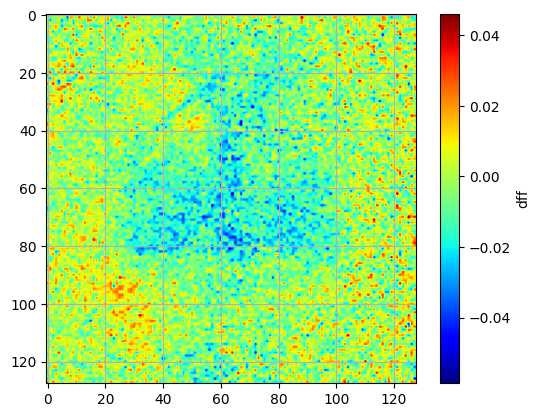

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:40,  3.12it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:38,  3.25it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:38,  3.23it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:38,  3.19it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:38,  3.16it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:39,  3.09it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:38,  3.14it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:39,  3.05it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:37,  3.14it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:38,  3.10it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:36,  3.24it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:34,  3.38it/s]

 10%|████████▏                                                                        | 13/128 [00:04<00:34,  3.36it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:34,  3.30it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:33,  3.35it/s]

 12%|██████████▏                                                                      | 16/128 [00:05<00:36,  3.10it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:36,  3.07it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:35,  3.10it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:33,  3.23it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:33,  3.22it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:34,  3.13it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:33,  3.21it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:33,  3.13it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:33,  3.09it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:32,  3.13it/s]

 20%|████████████████▍                                                                | 26/128 [00:08<00:33,  3.07it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:32,  3.11it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:32,  3.08it/s]

 23%|██████████████████▎                                                              | 29/128 [00:09<00:31,  3.15it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:30,  3.26it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:28,  3.36it/s]

 25%|████████████████████▎                                                            | 32/128 [00:10<00:29,  3.20it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:29,  3.24it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:28,  3.28it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:28,  3.32it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:11<00:27,  3.38it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:26,  3.42it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:26,  3.39it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:12<00:26,  3.30it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:26,  3.26it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:12<00:25,  3.42it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:13<00:26,  3.29it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:13<00:26,  3.27it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:13<00:26,  3.23it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:13<00:25,  3.22it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:14<00:25,  3.23it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:14<00:25,  3.21it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:14<00:25,  3.15it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:15<00:24,  3.24it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:23,  3.31it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:15<00:23,  3.34it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:16<00:22,  3.40it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:16<00:22,  3.38it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:16<00:21,  3.42it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:16<00:20,  3.48it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:17<00:21,  3.37it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:17<00:20,  3.41it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:17<00:20,  3.39it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:18<00:20,  3.44it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:18<00:20,  3.36it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:18<00:20,  3.32it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:19<00:19,  3.34it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:19<00:19,  3.34it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:19<00:19,  3.31it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:19<00:18,  3.45it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:20<00:18,  3.36it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:20<00:18,  3.33it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:20<00:18,  3.27it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:21<00:18,  3.22it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:21<00:17,  3.24it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:21<00:17,  3.29it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:22<00:17,  3.16it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:17,  3.20it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:22<00:16,  3.18it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:23<00:16,  3.18it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:23<00:16,  3.23it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:23<00:15,  3.33it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:23<00:15,  3.22it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:24<00:15,  3.24it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:24<00:16,  2.94it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:25<00:15,  2.94it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:25<00:14,  3.10it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:25<00:14,  3.15it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:25<00:14,  3.09it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:26<00:13,  3.09it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:26<00:13,  3.10it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:26<00:13,  3.03it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:27<00:13,  2.97it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:27<00:12,  3.06it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:27<00:12,  3.10it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:28<00:11,  3.14it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:28<00:11,  3.10it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:28<00:11,  3.15it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:29<00:10,  3.22it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:29<00:10,  3.17it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:29<00:10,  3.06it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:30<00:09,  3.18it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:30<00:09,  3.28it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:30<00:08,  3.33it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:30<00:08,  3.39it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:31<00:08,  3.37it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:31<00:07,  3.37it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:31<00:07,  3.39it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:32<00:07,  3.28it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:32<00:06,  3.35it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:32<00:06,  3.33it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:33<00:06,  3.24it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:33<00:06,  3.32it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:33<00:05,  3.40it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:33<00:05,  3.30it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:34<00:05,  3.34it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:34<00:04,  3.23it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:34<00:04,  3.26it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:35<00:04,  3.32it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:35<00:03,  3.32it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:35<00:03,  3.27it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:36<00:03,  3.34it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:36<00:02,  3.37it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:36<00:02,  3.35it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:37<00:02,  3.20it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:37<00:02,  3.25it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:37<00:01,  3.38it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:37<00:01,  3.28it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:38<00:01,  3.18it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:38<00:00,  3.32it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:38<00:00,  3.38it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:39<00:00,  3.39it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.37it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.25it/s]

frame number 200 plotted


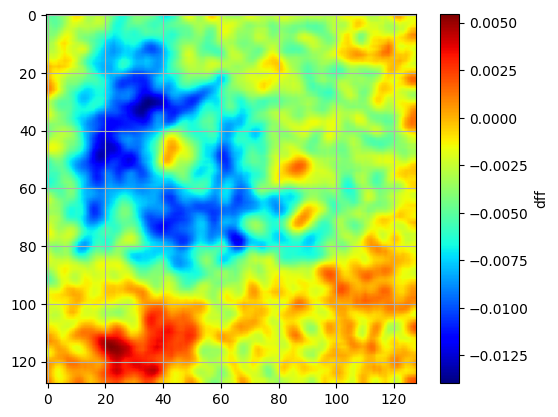

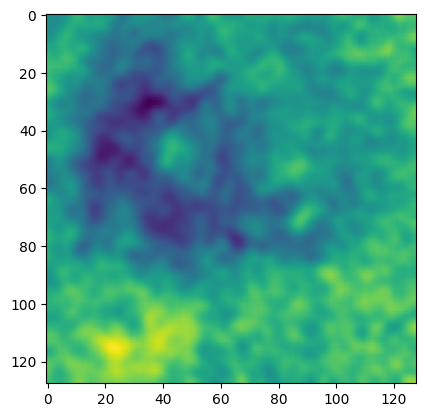

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 20


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 41
fail = 3
total trials = 44


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 24
fail = 12
total trials = 36


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 5
fail = 15
total trials = 20


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34142 [00:00<?, ?it/s]

  7%|█████                                                                     | 2308/34142 [00:00<00:01, 22859.35it/s]

 14%|██████████▎                                                               | 4749/34142 [00:00<00:01, 23634.16it/s]

 21%|███████████████▊                                                          | 7270/34142 [00:00<00:01, 24243.59it/s]

 28%|█████████████████████                                                     | 9695/34142 [00:00<00:01, 23874.58it/s]

 35%|█████████████████████████▊                                               | 12084/34142 [00:00<00:00, 23859.55it/s]

 42%|██████████████████████████████▉                                          | 14471/34142 [00:00<00:00, 23163.88it/s]

 49%|███████████████████████████████████▉                                     | 16791/34142 [00:00<00:00, 21790.85it/s]

 56%|█████████████████████████████████████████                                | 19191/34142 [00:00<00:00, 22387.80it/s]

 63%|█████████████████████████████████████████████▉                           | 21456/34142 [00:00<00:00, 22401.45it/s]

 70%|███████████████████████████████████████████████████▏                     | 23934/34142 [00:01<00:00, 23069.28it/s]

 77%|████████████████████████████████████████████████████████▏                | 26250/34142 [00:01<00:00, 22451.31it/s]

 83%|████████████████████████████████████████████████████████████▉            | 28504/34142 [00:01<00:00, 21593.37it/s]

 91%|██████████████████████████████████████████████████████████████████▊      | 31225/34142 [00:01<00:00, 23140.83it/s]

100%|████████████████████████████████████████████████████████████████████████▋| 33989/34142 [00:01<00:00, 24377.98it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34142/34142 [00:01<00:00, 23052.03it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 22230.31it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 22229.72it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")